In [1]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt

In [2]:
activity_codes_mapping = {'A': 'walking',
                          'B': 'jogging',
                          'C': 'stairs',
                          'D': 'sitting',
                          'E': 'standing',
                          'F': 'typing',
                          'G': 'brushing teeth',
                          'H': 'eating soup',
                          'I': 'eating chips',
                          'J': 'eating pasta',
                          'K': 'drinking from cup',
                          'L': 'eating sandwich',
                          'M': 'kicking soccer ball',
                          'O': 'playing catch tennis ball',
                          'P': 'dribbling basket ball',
                          'Q': 'writing',
                          'R': 'clapping',
                          'S': 'folding clothes'}

activity_color_map = {activity_codes_mapping['A']: 'lime',
                      activity_codes_mapping['B']: 'red',
                      activity_codes_mapping['C']: 'blue',
                      activity_codes_mapping['D']: 'orange',
                      activity_codes_mapping['E']: 'yellow',
                      activity_codes_mapping['F']: 'lightgreen',
                      activity_codes_mapping['G']: 'greenyellow',
                      activity_codes_mapping['H']: 'magenta',
                      activity_codes_mapping['I']: 'gold',
                      activity_codes_mapping['J']: 'cyan',
                      activity_codes_mapping['K']: 'purple',
                      activity_codes_mapping['L']: 'lightgreen',
                      activity_codes_mapping['M']: 'violet',
                      activity_codes_mapping['O']: 'limegreen',
                      activity_codes_mapping['P']: 'deepskyblue',   
                      activity_codes_mapping['Q']: 'mediumspringgreen',
                      activity_codes_mapping['R']: 'plum',
                      activity_codes_mapping['S']: 'olive'}
#                     activity_codes_mapping['A']: 'rgb(231, 41, 138)',
                          

In [3]:
def show_accel_per_activity(device, df, act, interval_in_sec = None):


  df1 = df.loc[df.activity == act].copy()
  df1.reset_index(drop = True, inplace = True)

  df1['duration'] = (df1['timestamp'] - df1['timestamp'].iloc[0])/1000000000 

  if interval_in_sec == None:
    ax = df1[:].plot(kind='line', x='duration', y=['x','y','z'], figsize=(25,7), grid = True) 
  else:
    ax = df1[:interval_in_sec*20].plot(kind='line', x='duration', y=['x','y','z'], figsize=(25,7), grid = True) 

  ax.set_xlabel('duration  (sec)', fontsize = 15)
  ax.set_ylabel('acceleration  (m/sec^2)',fontsize = 15)
  ax.set_title('Acceleration:   Device: ' + device + '      Activity:  ' + act, fontsize = 15)



In [4]:
def show_ang_velocity_per_activity(device, df, act, interval_in_sec = None):
  

  df1 = df.loc[df.activity == act].copy()
  df1.reset_index(drop = True, inplace = True)

  df1['duration'] = (df1['timestamp'] - df1['timestamp'].iloc[0])/1000000000 

  if interval_in_sec == None:
    ax = df1[:].plot(kind='line', x='duration', y=['x','y','z'], figsize=(25,7), grid = True) 
  else:
    ax = df1[:interval_in_sec*20].plot(kind='line', x='duration', y=['x','y','z'], figsize=(25,7), grid = True) 

  ax.set_xlabel('duration  (sec)', fontsize = 15)
  ax.set_ylabel('angular velocity  (rad/sec)',fontsize = 15)
  ax.set_title('Angular velocity:  Device: ' + device + '      Activity:  ' + act, fontsize = 15)



In [5]:
raw_par_10_phone_accel = pd.read_csv(r'./wisdm-dataset/raw/phone/accel/data_1610_accel_phone.txt', names = ['participant_id' , 'activity_code' , 'timestamp', 'x', 'y', 'z'], index_col=None, header=None)

raw_par_10_phone_accel.z = raw_par_10_phone_accel.z.str.strip(';')
raw_par_10_phone_accel.z = pd.to_numeric(raw_par_10_phone_accel.z)

raw_par_10_phone_accel['activity'] = raw_par_10_phone_accel['activity_code'].map(activity_codes_mapping)

raw_par_10_phone_accel = raw_par_10_phone_accel[['participant_id', 'activity_code', 'activity', 'timestamp', 'x', 'y', 'z']]

raw_par_10_phone_accel


,participant_id,activity_code,activity,timestamp,x,y,z
0,1610,A,walking,18687441561967,1.174957,13.347473,-4.034637
1,1610,A,walking,18687491915971,1.408188,7.091858,-3.895721
2,1610,A,walking,18687542269974,4.932510,6.306808,-2.339004
3,1610,A,walking,18687592623978,0.154648,6.123505,-1.831467
4,1610,A,walking,18687642977982,-2.826035,4.180542,-3.211899
...,...,...,...,...,...,...,...
80865,1610,S,folding clothes,17989031516129,5.946732,7.583008,-1.097259
80866,1610,S,folding clothes,17989081870133,5.818741,7.804871,-1.623733
80867,1610,S,folding clothes,17989132224137,5.530823,7.636093,-1.662643
80868,1610,S,folding clothes,17989182578141,5.802170,7.645752,-1.000412


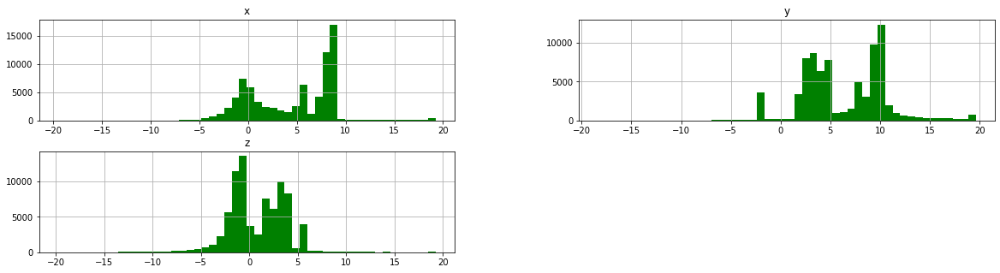

In [6]:
T = raw_par_10_phone_accel
_ = T[['x', 'y', 'z']].hist(bins = 50, figsize = (20, 5), color='green')

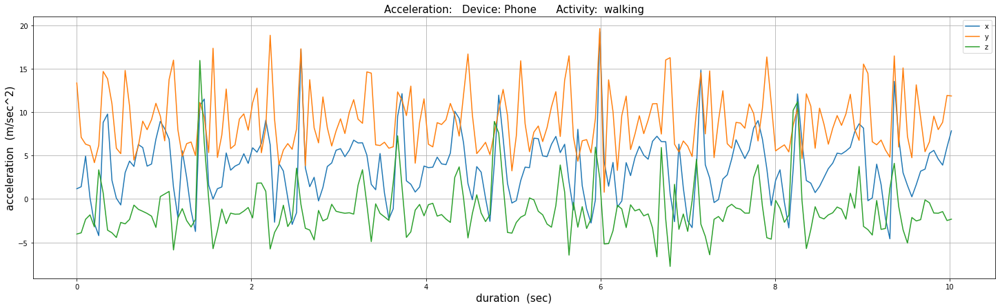

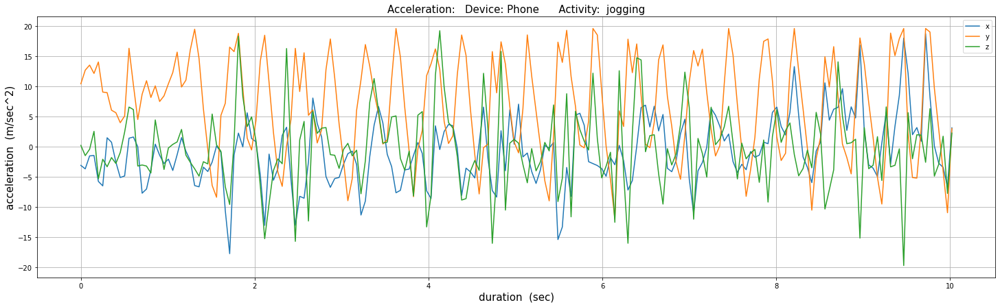

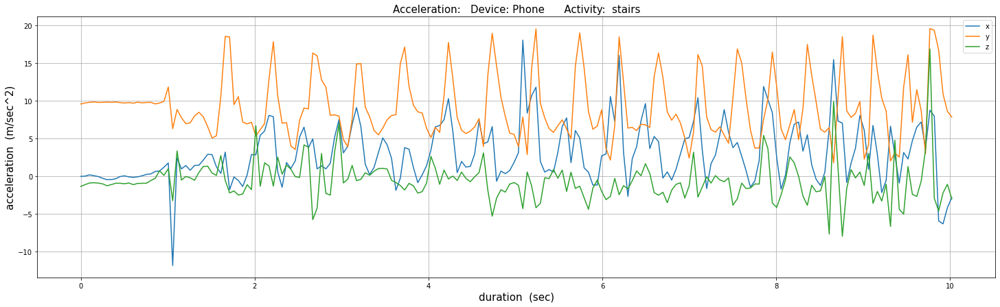

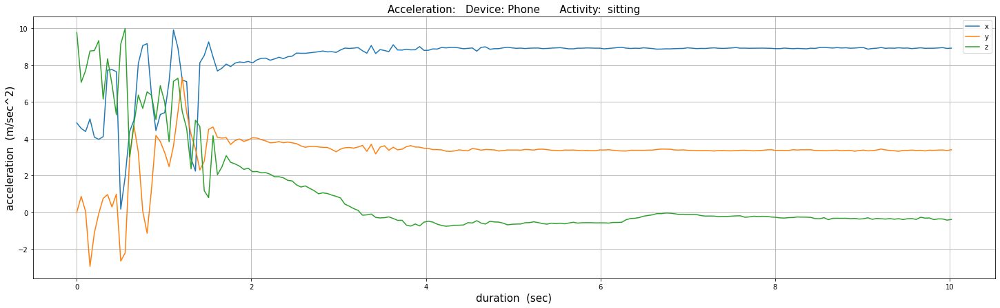

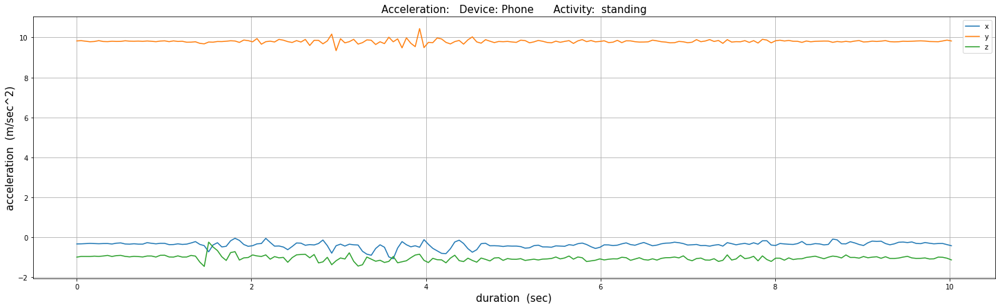

...

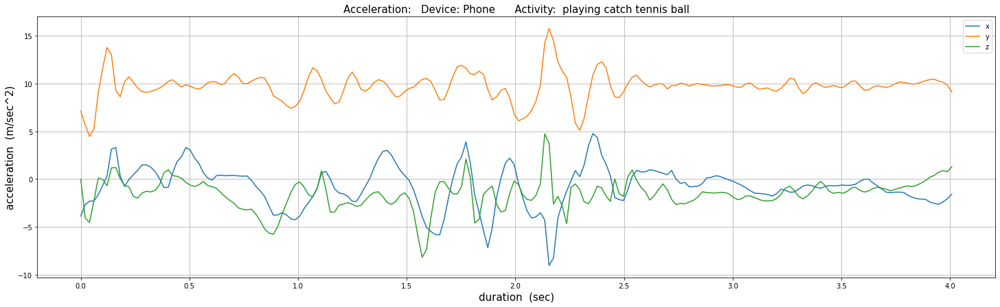

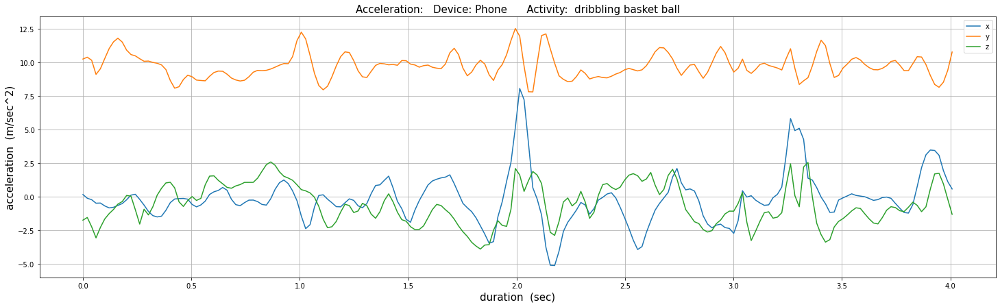

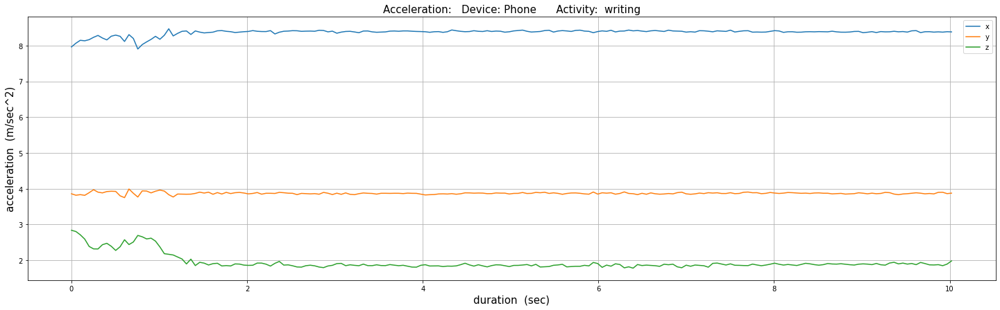

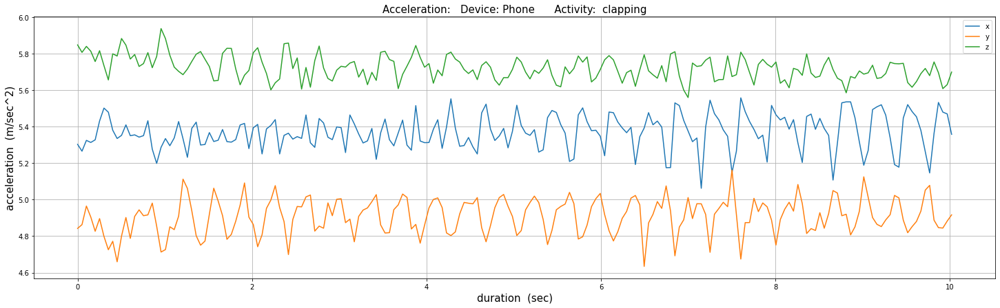

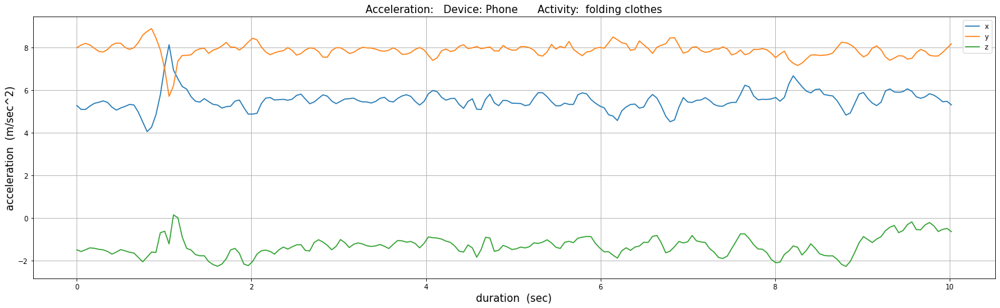

In [7]:
for key in activity_codes_mapping:
  show_accel_per_activity('Phone', raw_par_10_phone_accel, activity_codes_mapping[key], 10)


In [8]:
raw_par_20_watch_accel = pd.read_csv(r'./wisdm-dataset/raw/watch/accel/data_1620_accel_watch.txt', names = ['participant_id' , 'activity_code' , 'timestamp', 'x', 'y', 'z'], index_col=None, header=None)

raw_par_20_watch_accel.z = raw_par_20_watch_accel.z.str.strip(';')
raw_par_20_watch_accel.z = pd.to_numeric(raw_par_20_watch_accel.z)

raw_par_20_watch_accel['activity'] = raw_par_20_watch_accel['activity_code'].map(activity_codes_mapping)

raw_par_20_watch_accel = raw_par_20_watch_accel[['participant_id', 'activity_code', 'activity', 'timestamp', 'x', 'y', 'z']]

raw_par_20_watch_accel


,participant_id,activity_code,activity,timestamp,x,y,z
0,1620,A,walking,37945621841814,3.417424,-2.164957,-4.849306
1,1620,A,walking,37945671341814,5.423765,-6.936601,-4.954651
2,1620,A,walking,37945720841814,4.700716,-3.127426,-7.648128
3,1620,A,walking,37945770341814,8.033444,-4.700417,-5.024083
4,1620,A,walking,37945819841814,3.970484,-1.645415,-3.621080
...,...,...,...,...,...,...,...
67189,1620,S,folding clothes,42368439960621,6.524798,-4.589834,0.573262
67190,1620,S,folding clothes,42368489889911,9.100959,-4.168455,-0.602291
67191,1620,S,folding clothes,42368539819201,7.590218,-5.736657,-1.854459
67192,1620,S,folding clothes,42368589748491,8.681973,-6.284929,-5.180005


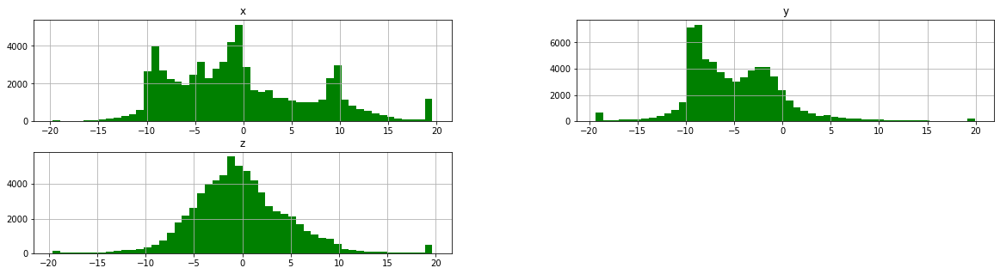

In [9]:
T = raw_par_20_watch_accel
_ = T[['x', 'y', 'z']].hist(bins = 50, figsize = (20, 5), color='green')

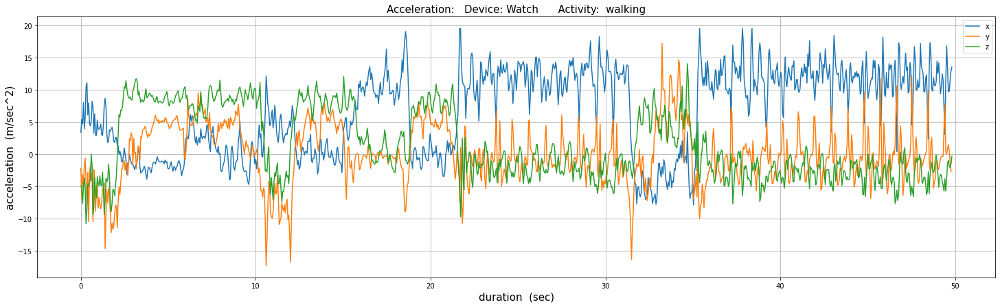

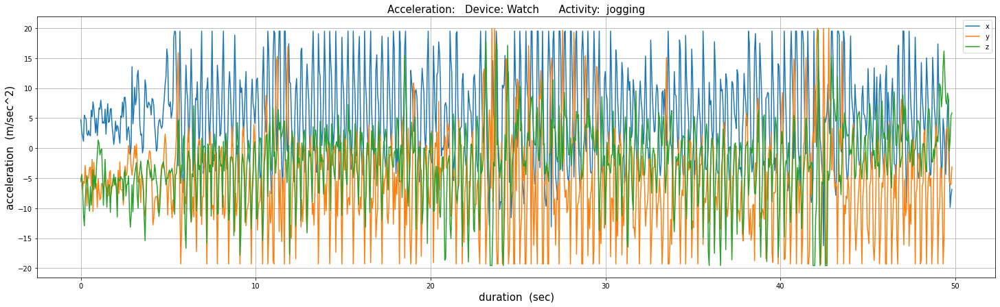

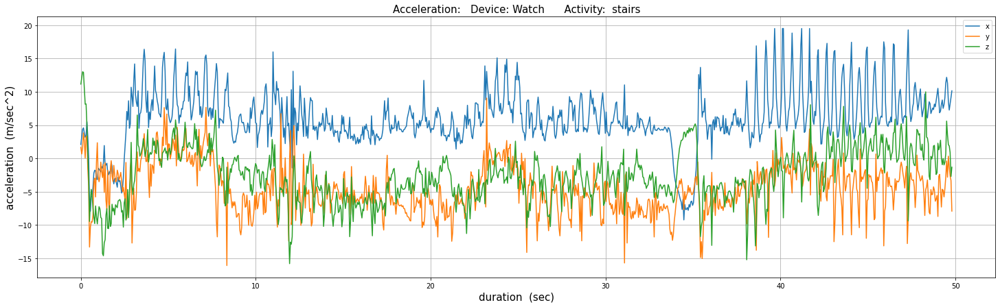

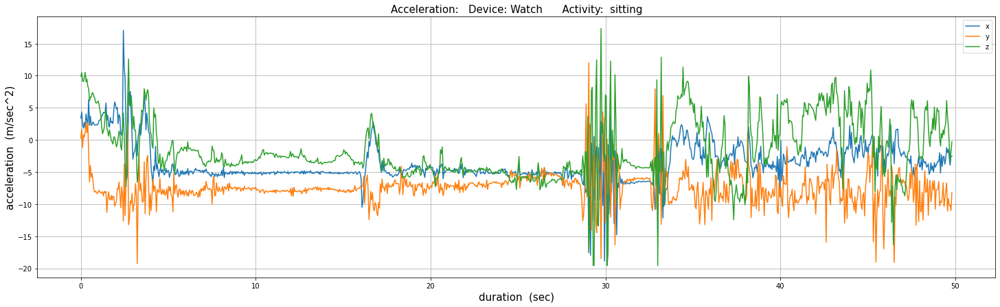

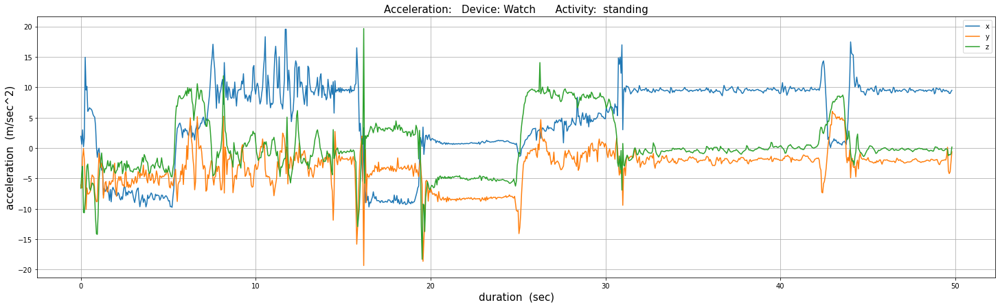

...

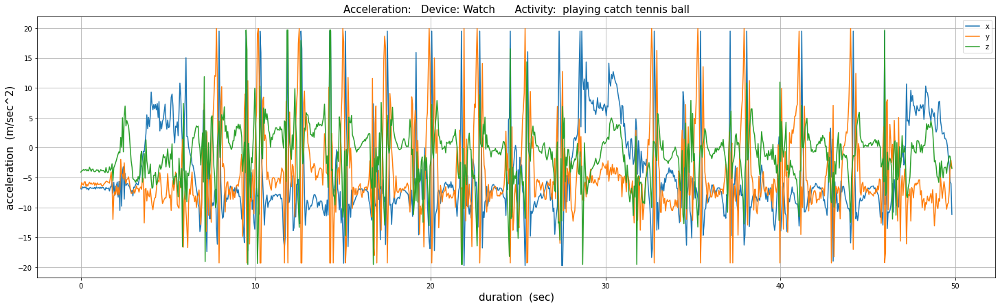

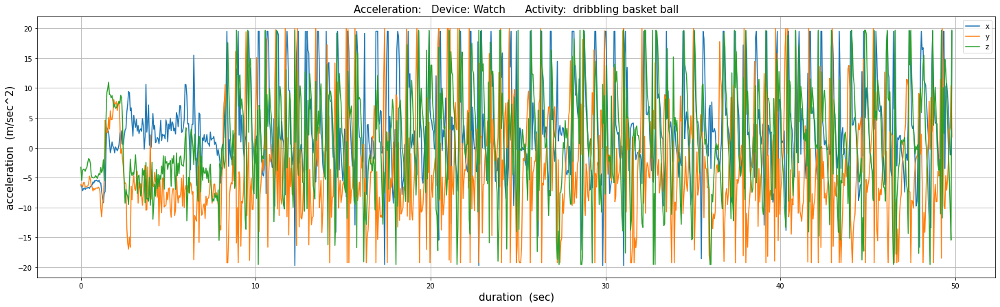

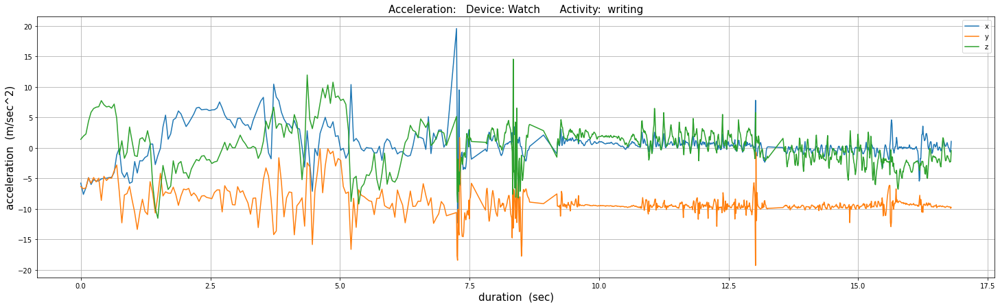

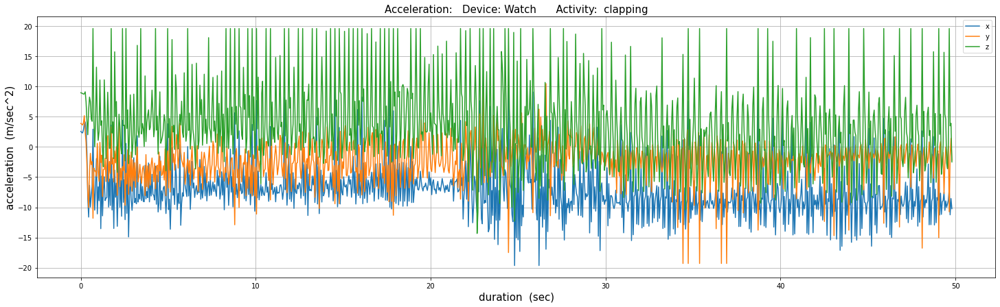

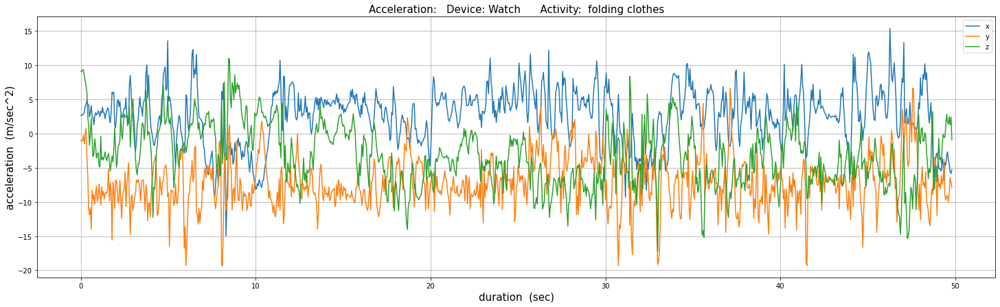

In [10]:
for key in activity_codes_mapping:
  show_accel_per_activity('Watch', raw_par_20_watch_accel, activity_codes_mapping[key], 50)

In [11]:
raw_par_35_phone_ang_vel = pd.read_csv(r'./wisdm-dataset/raw/phone/gyro/data_1635_gyro_phone.txt', names = ['participant_id' , 'activity_code' , 'timestamp', 'x', 'y', 'z'], index_col=None, header=None)

raw_par_35_phone_ang_vel.z = raw_par_35_phone_ang_vel.z.str.strip(';')
raw_par_35_phone_ang_vel.z = pd.to_numeric(raw_par_35_phone_ang_vel.z)

raw_par_35_phone_ang_vel['activity'] = raw_par_35_phone_ang_vel['activity_code'].map(activity_codes_mapping)

raw_par_35_phone_ang_vel = raw_par_35_phone_ang_vel[['participant_id', 'activity_code', 'activity', 'timestamp', 'x', 'y', 'z']]

raw_par_35_phone_ang_vel

,participant_id,activity_code,activity,timestamp,x,y,z
0,1635,A,walking,676165107876419,0.874725,-0.098099,0.807510
1,1635,A,walking,676165158230423,0.563431,-1.359665,1.432419
2,1635,A,walking,676165208584427,1.507690,-3.086883,0.679016
3,1635,A,walking,676165258938431,1.430603,-1.860306,0.451035
4,1635,A,walking,676165309292435,0.325165,-1.735611,0.252365
...,...,...,...,...,...,...,...
64530,1635,S,folding clothes,680277872380268,-0.119614,-0.032928,0.129654
64531,1635,S,folding clothes,680277922750286,-0.500427,-0.465652,0.098923
64532,1635,S,folding clothes,680277973104290,-0.768646,-0.448929,0.063583
64533,1635,S,folding clothes,680278023458294,-0.786408,-0.346924,0.099899


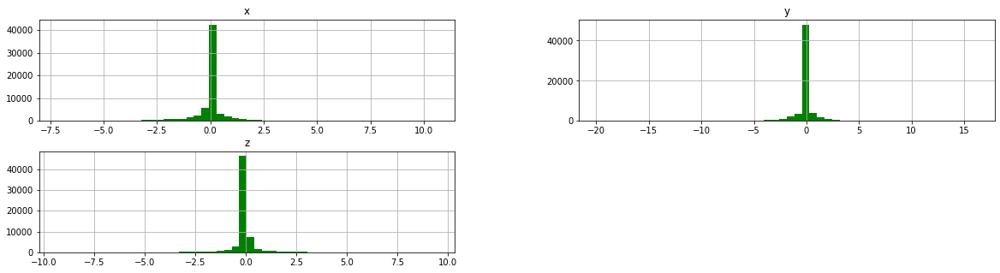

In [12]:
T = raw_par_35_phone_ang_vel
_ = T[['x', 'y', 'z']].hist(bins = 50, figsize = (20, 5), color='green')

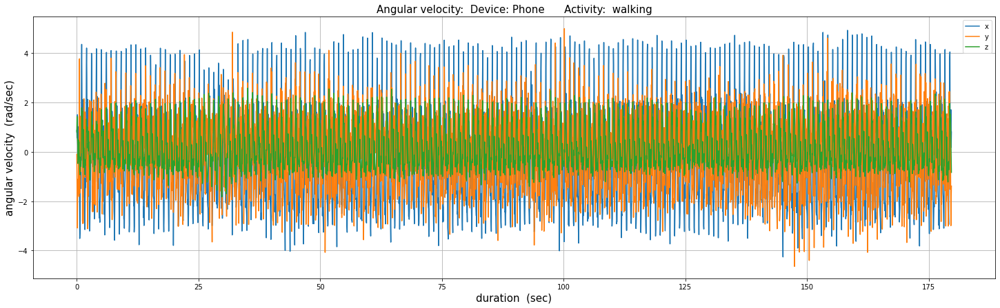

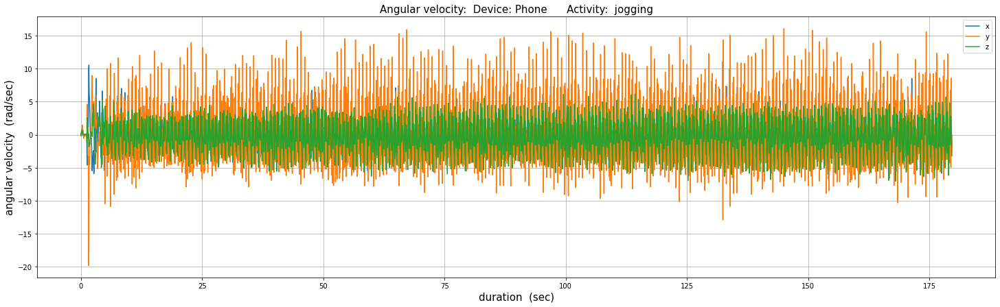

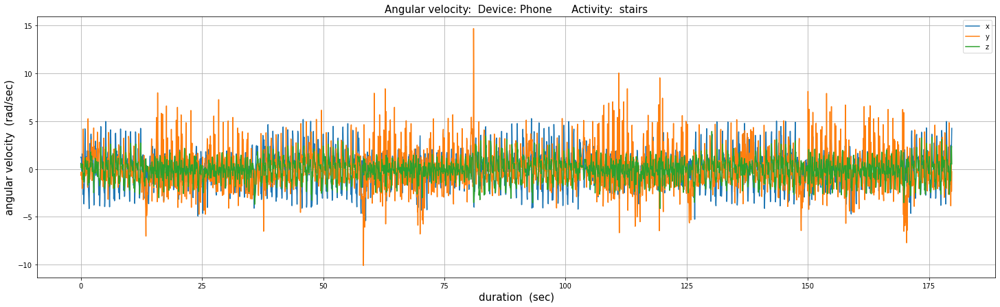

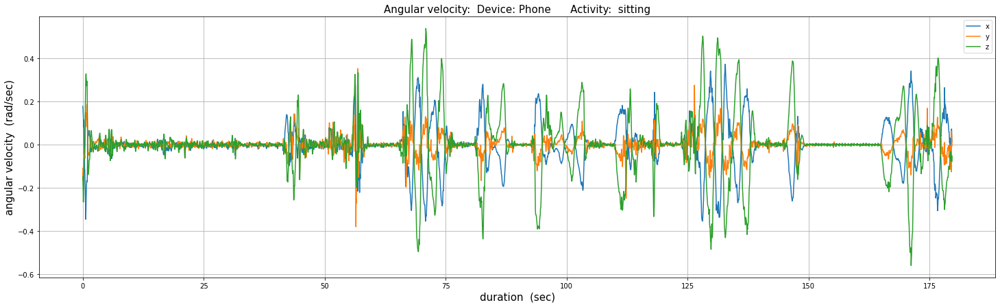

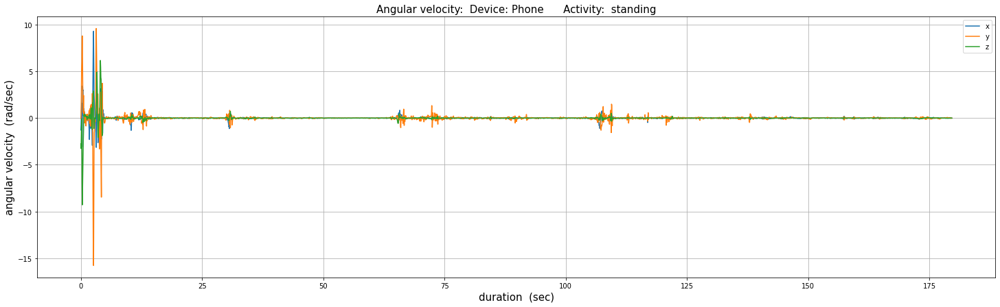

...

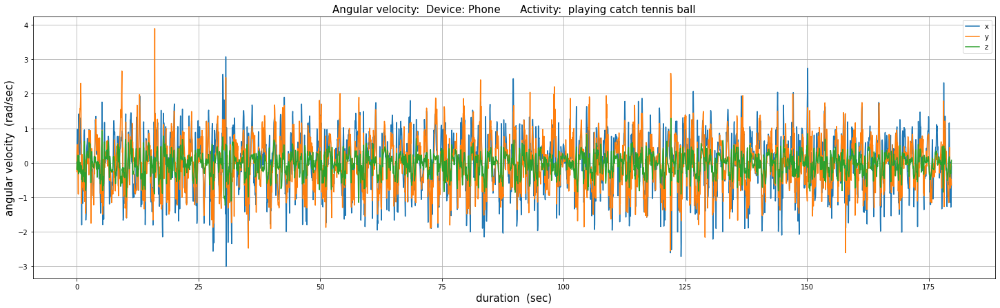

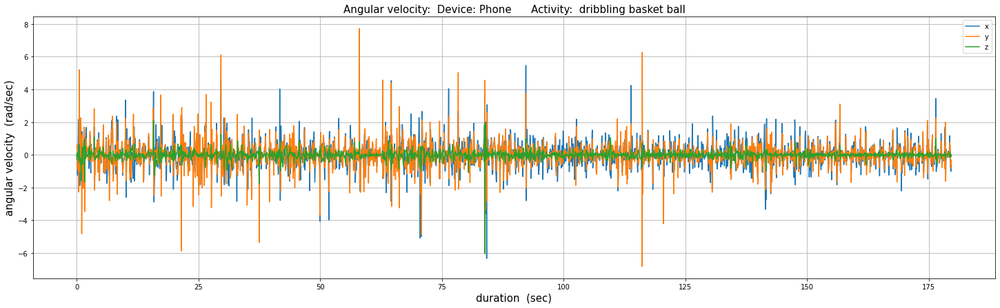

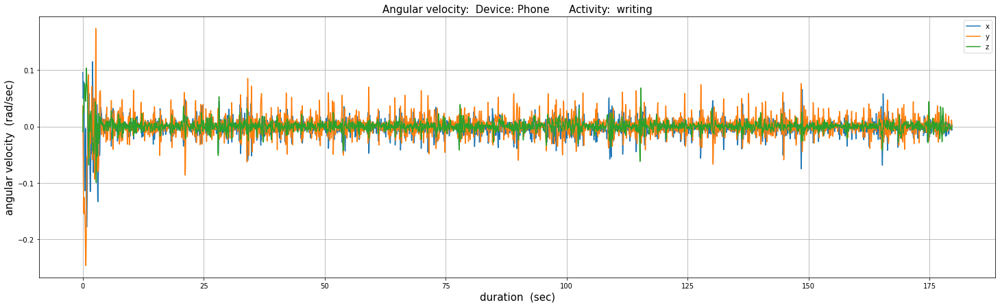

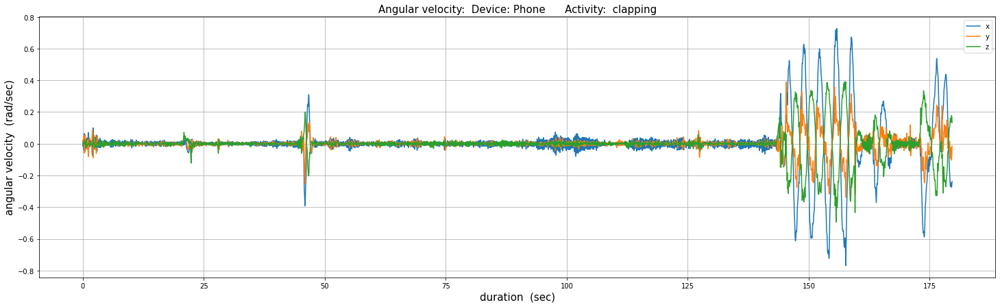

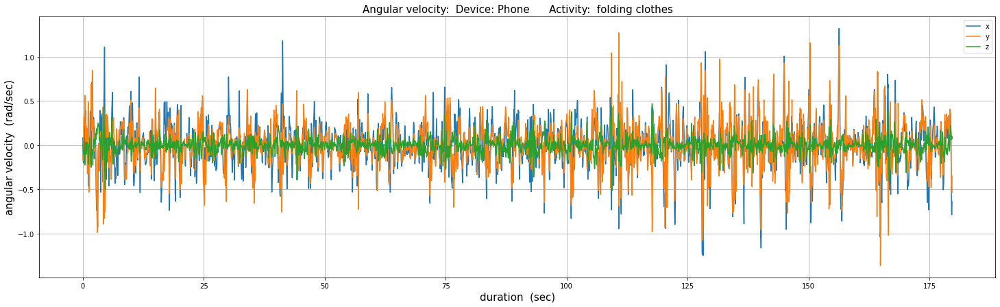

In [13]:
for key in activity_codes_mapping:
  show_ang_velocity_per_activity('Phone', raw_par_35_phone_ang_vel, activity_codes_mapping[key])

In [14]:
raw_par_45_watch_ang_vel = pd.read_csv(r'./wisdm-dataset/raw/watch/gyro/data_1635_gyro_watch.txt', names = ['participant_id' , 'activity_code' , 'timestamp', 'x', 'y', 'z'], index_col=None, header=None)

raw_par_45_watch_ang_vel.z = raw_par_45_watch_ang_vel.z.str.strip(';')
raw_par_45_watch_ang_vel.z = pd.to_numeric(raw_par_45_watch_ang_vel.z)

raw_par_45_watch_ang_vel['activity'] = raw_par_45_watch_ang_vel['activity_code'].map(activity_codes_mapping)

raw_par_45_watch_ang_vel = raw_par_45_watch_ang_vel[['participant_id', 'activity_code', 'activity', 'timestamp', 'x', 'y', 'z']]

raw_par_45_watch_ang_vel

,participant_id,activity_code,activity,timestamp,x,y,z
0,1635,A,walking,64768437041043,0.117911,-0.145542,-1.300821
1,1635,A,walking,64768486541043,1.038300,-0.455534,-1.134640
2,1635,A,walking,64768536041043,0.876380,-0.541820,-0.844888
3,1635,A,walking,64768585541043,0.912599,-0.388422,-0.394281
4,1635,A,walking,64768635041043,0.048669,-0.046472,0.288553
...,...,...,...,...,...,...,...
64853,1635,S,folding clothes,68881084984774,-0.426159,0.298781,2.808190
64854,1635,S,folding clothes,68881134912344,1.008752,-0.439448,2.320299
64855,1635,S,folding clothes,68881184839914,0.938445,-0.437317,1.726947
64856,1635,S,folding clothes,68881234767484,1.552037,-0.296702,1.282732


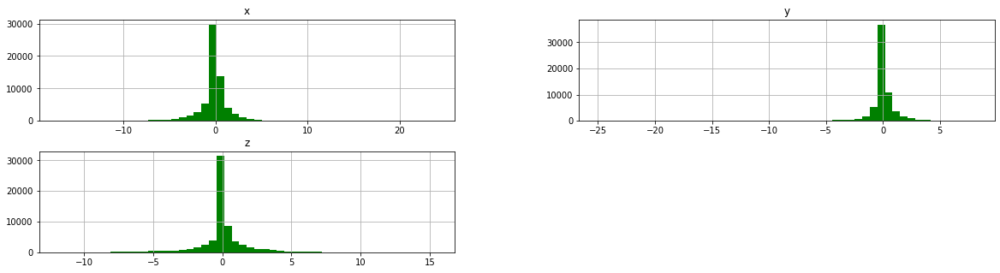

In [15]:
T = raw_par_45_watch_ang_vel
_ = T[['x', 'y', 'z']].hist(bins = 50, figsize = (20, 5), color='green')

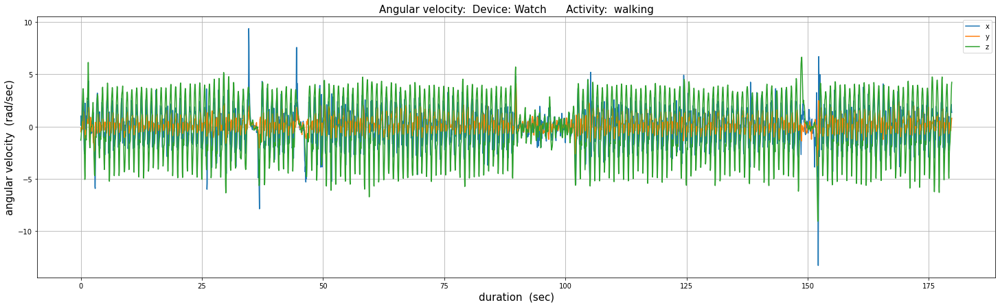

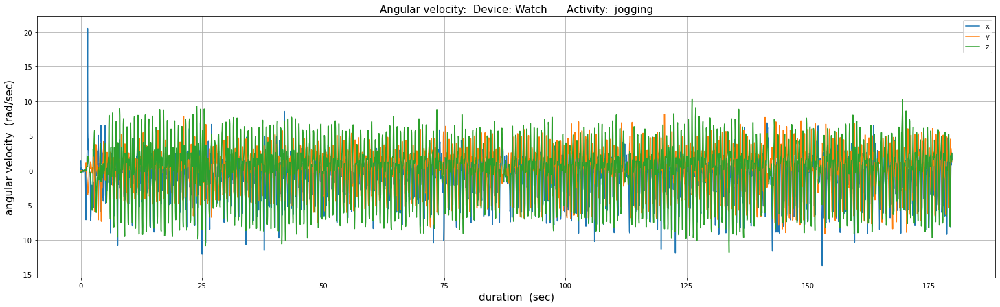

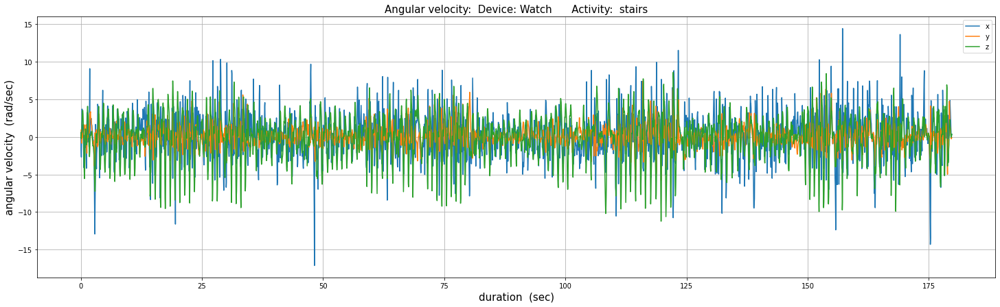

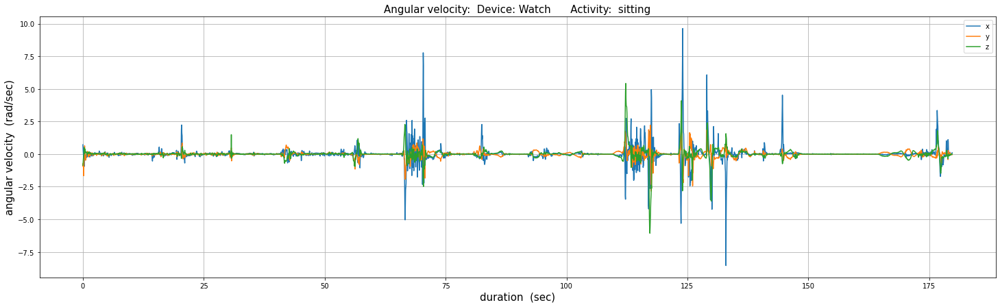

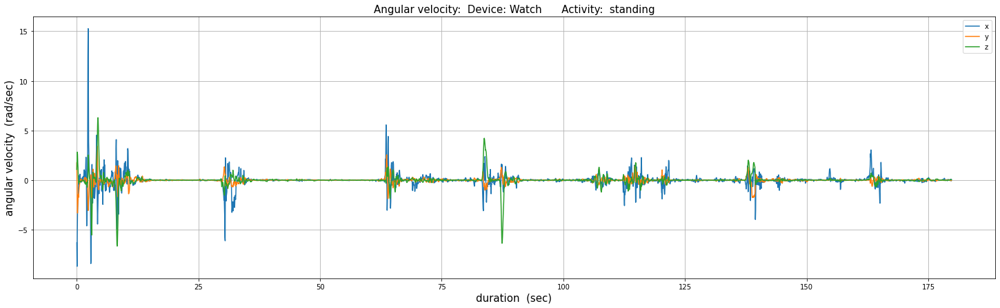

...

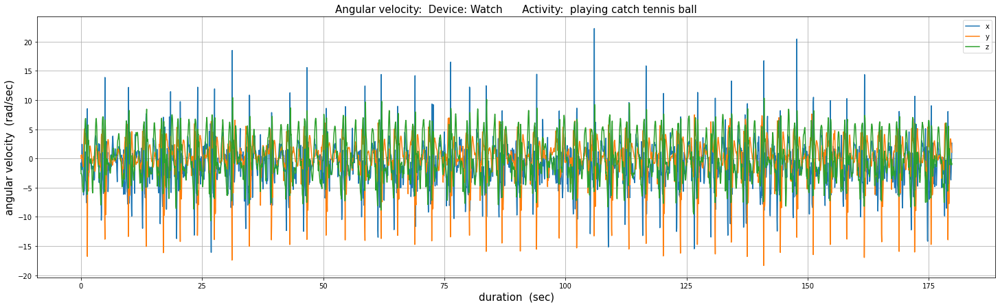

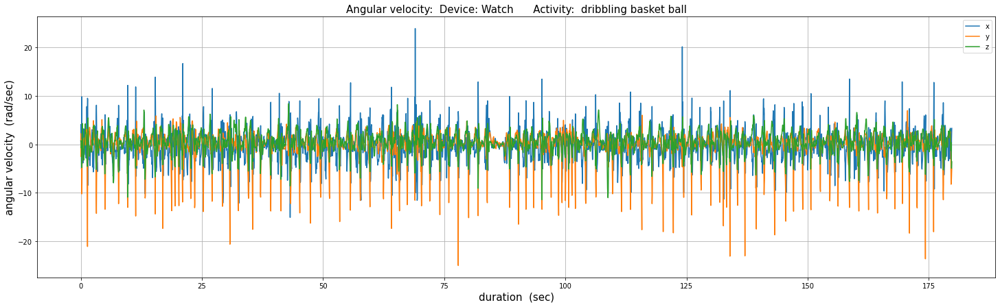

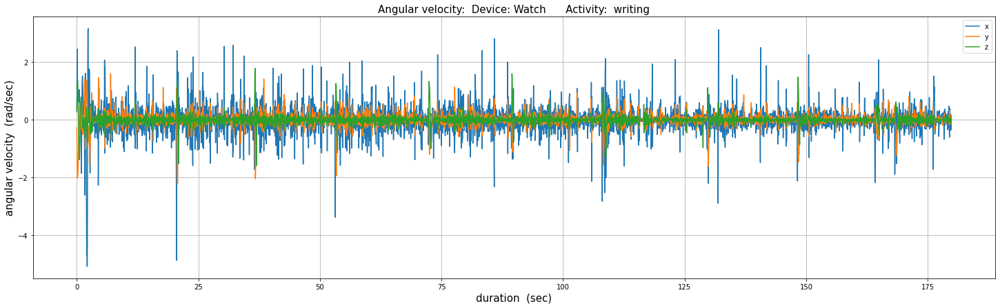

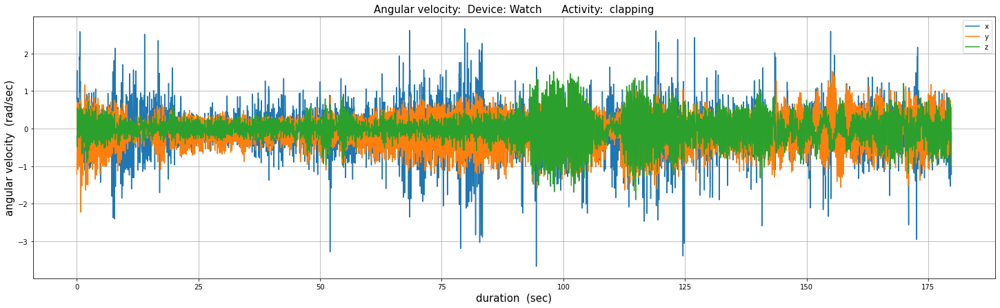

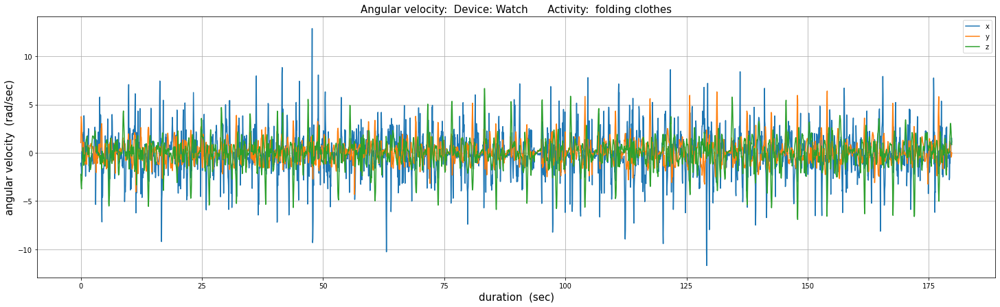

In [16]:
for key in activity_codes_mapping:
  show_ang_velocity_per_activity('Watch', raw_par_45_watch_ang_vel, activity_codes_mapping[key])

In [17]:
features = ['ACTIVITY',
            'X0', 
            'X1', 
            'X2',
            'X3',
            'X4',
            'X5',
            'X6',
            'X7',
            'X8',
            'X9',
            'Y0', 
            'Y1', 
            'Y2',
            'Y3',
            'Y4',
            'Y5',
            'Y6',
            'Y7',
            'Y8',
            'Y9',
            'Z0', 
            'Z1', 
            'Z2',
            'Z3',
            'Z4',
            'Z5',
            'Z6',
            'Z7',
            'Z8',
            'Z9',
            'XAVG',
            'YAVG',
            'ZAVG',
            'XPEAK', 
            'YPEAK',
            'ZPEAK',
            'XABSOLDEV',
            'YABSOLDEV',
            'ZABSOLDEV',
            'XSTANDDEV',
            'YSTANDDEV',
            'ZSTANDDEV',
            'XVAR',
            'YVAR',
            'ZVAR',
            'XMFCC0', 
            'XMFCC1',
            'XMFCC2',
            'XMFCC3',
            'XMFCC4',
            'XMFCC5',
            'XMFCC6',
            'XMFCC7',
            'XMFCC8',
            'XMFCC9',
            'XMFCC10',
            'XMFCC11',
            'XMFCC12',
            'YMFCC0',
            'YMFCC1',
            'YMFCC2',
            'YMFCC3',
            'YMFCC4',
            'YMFCC5',
            'YMFCC6',
            'YMFCC7',
            'YMFCC8',
            'YMFCC9',
            'YMFCC10',
            'YMFCC11',
            'YMFCC12',
            'ZMFCC0', 
            'ZMFCC1',
            'ZMFCC2',
            'ZMFCC3',
            'ZMFCC4',
            'ZMFCC5',
            'ZMFCC6',
            'ZMFCC7',
            'ZMFCC8',
            'ZMFCC9',
            'ZMFCC10',
            'ZMFCC11',
            'ZMFCC12',
            'XYCOS', 
            'XZCOS',
            'YZCOS',
            'XYCOR',
            'XZCOR',
            'YZCOR',
            'RESULTANT',
            'PARTICIPANT'] 

len(features)

93

In [18]:
import glob

duplicate_files = [str(i) for i in range(1611, 1618)] 

path = r'./wisdm-dataset/arff_files/phone/accel'
all_files = glob.glob(path + "/*.arff")

list_dfs_phone_accel = []

for filename in all_files:

    if any(dup_fn in filename for dup_fn in duplicate_files):
        continue 
    df = pd.read_csv(filename, names = features, skiprows = 96, index_col=None, header=0)
    list_dfs_phone_accel.append(df)

all_phone_accel = pd.concat(list_dfs_phone_accel, axis=0, ignore_index=True, sort=False)

all_phone_accel

,ACTIVITY,X0,X1,X2,X3,X4,X5,X6,X7,X8,...,ZMFCC11,ZMFCC12,XYCOS,XZCOS,YZCOS,XYCOR,XZCOR,YZCOR,RESULTANT,PARTICIPANT
0,A,0.120,0.235,0.230,0.200,0.07,0.120,0.025,0.000,0.000,...,0.579626,0.572178,0.179066,0.334143,0.201998,-0.344658,0.091264,-0.560901,10.22530,1621
1,A,0.175,0.160,0.255,0.185,0.13,0.035,0.040,0.020,0.000,...,0.588959,0.581391,0.405854,0.544716,-0.219627,0.294625,0.719457,0.231761,11.20890,1621
2,A,0.205,0.180,0.185,0.190,0.10,0.035,0.070,0.035,0.000,...,0.597990,0.590305,0.343374,0.569779,-0.250478,0.187806,0.739889,0.200274,11.56810,1621
3,A,0.270,0.175,0.155,0.170,0.08,0.055,0.045,0.045,0.005,...,0.617620,0.609684,0.250688,0.646107,-0.183269,0.221665,0.723577,0.121199,11.92590,1621
4,A,0.265,0.190,0.175,0.125,0.06,0.060,0.050,0.060,0.015,...,0.614112,0.606221,0.273288,0.643054,-0.128053,0.276439,0.709318,0.184426,12.09840,1621
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20645,S,0.000,0.375,0.625,0.000,0.00,0.000,0.000,0.000,0.000,...,0.251476,0.248244,0.008413,0.208618,0.766618,-0.252847,0.309428,-0.202055,9.71989,1634
20646,S,0.000,0.510,0.490,0.000,0.00,0.000,0.000,0.000,0.000,...,0.230234,0.227275,0.238739,0.571442,0.775156,-0.178233,0.627990,-0.238000,9.74689,1634
20647,S,0.000,0.460,0.540,0.000,0.00,0.000,0.000,0.000,0.000,...,0.210665,0.207958,0.221541,0.342222,0.763087,-0.127903,0.271676,-0.136703,9.71072,1634
20648,S,0.020,0.360,0.620,0.000,0.00,0.000,0.000,0.000,0.000,...,0.229694,0.226742,0.138189,0.121092,0.842748,-0.156089,0.001341,0.048678,9.73916,1634


In [19]:
all_phone_accel.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20650 entries, 0 to 20649
Data columns (total 93 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   ACTIVITY     20650 non-null  object 
 1   X0           20650 non-null  float64
 2   X1           20650 non-null  float64
 3   X2           20650 non-null  float64
 4   X3           20650 non-null  float64
 5   X4           20650 non-null  float64
 6   X5           20650 non-null  float64
 7   X6           20650 non-null  float64
 8   X7           20650 non-null  float64
 9   X8           20650 non-null  float64
 10  X9           20650 non-null  float64
 11  Y0           20650 non-null  float64
 12  Y1           20650 non-null  float64
 13  Y2           20650 non-null  float64
 14  Y3           20650 non-null  float64
 15  Y4           20650 non-null  float64
 16  Y5           20650 non-null  float64
 17  Y6           20650 non-null  float64
 18  Y7           20650 non-null  float64
 19  Y8  

In [20]:
all_phone_accel_breakpoint = all_phone_accel.copy()

In [21]:
all_phone_accel['ACTIVITY'].map(activity_codes_mapping).value_counts()

drinking from cup            1202
kicking soccer ball          1196
jogging                      1194
standing                     1175
brushing teeth               1174
walking                      1169
clapping                     1162
playing catch tennis ball    1161
sitting                      1155
folding clothes              1153
dribbling basket ball        1149
eating soup                  1144
eating sandwich              1134
writing                      1133
eating chips                 1128
eating pasta                 1077
stairs                       1072
typing                       1072
Name: ACTIVITY, dtype: int64

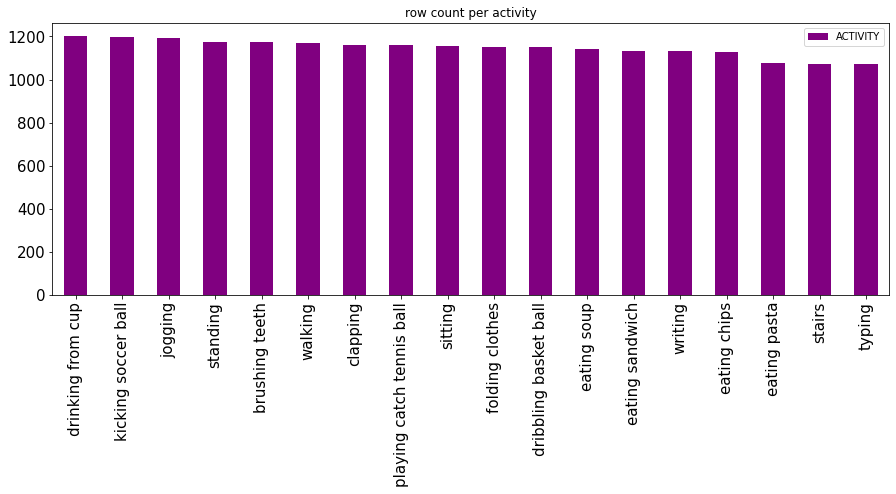

In [22]:
_ = all_phone_accel['ACTIVITY'].map(activity_codes_mapping).value_counts().plot(kind = 'bar', figsize = (15,5), color = 'purple', title = 'row count per activity', legend = True, fontsize = 15)

In [24]:
all_phone_accel[['XABSOLDEV', 'YABSOLDEV','ZABSOLDEV','XSTANDDEV', 'YSTANDDEV', 'ZSTANDDEV', 'XVAR', 'YVAR', 'ZVAR']].head()

,XABSOLDEV,YABSOLDEV,ZABSOLDEV,XSTANDDEV,YSTANDDEV,ZSTANDDEV,XVAR,YVAR,ZVAR
0,3.35451,3.47979,4.34645,0.294216,0.301694,0.356940,0.542417,0.549267,0.597445
1,3.66872,2.28165,3.10764,0.335432,0.204393,0.273103,0.579165,0.452099,0.522592
2,4.25412,2.36380,3.27091,0.381933,0.204301,0.290835,0.618007,0.451996,0.539291
3,4.76650,2.47409,3.55678,0.432089,0.219477,0.317545,0.657334,0.468483,0.563512
4,5.08736,2.65661,3.59664,0.462684,0.233042,0.314251,0.680209,0.482744,0.560581


In [25]:
all_phone_accel.drop(['XSTANDDEV','YSTANDDEV','ZSTANDDEV','XVAR','YVAR','ZVAR'], axis = 1, inplace = True)

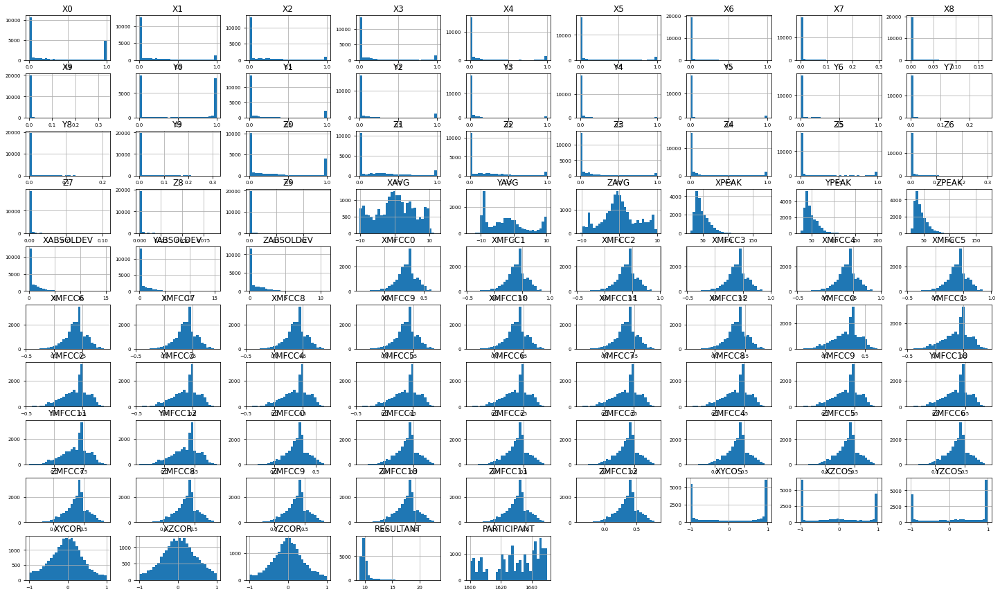

In [26]:
ax = all_phone_accel.hist(bins=30, figsize=(25, 15), xlabelsize = 7, ylabelsize = 7)

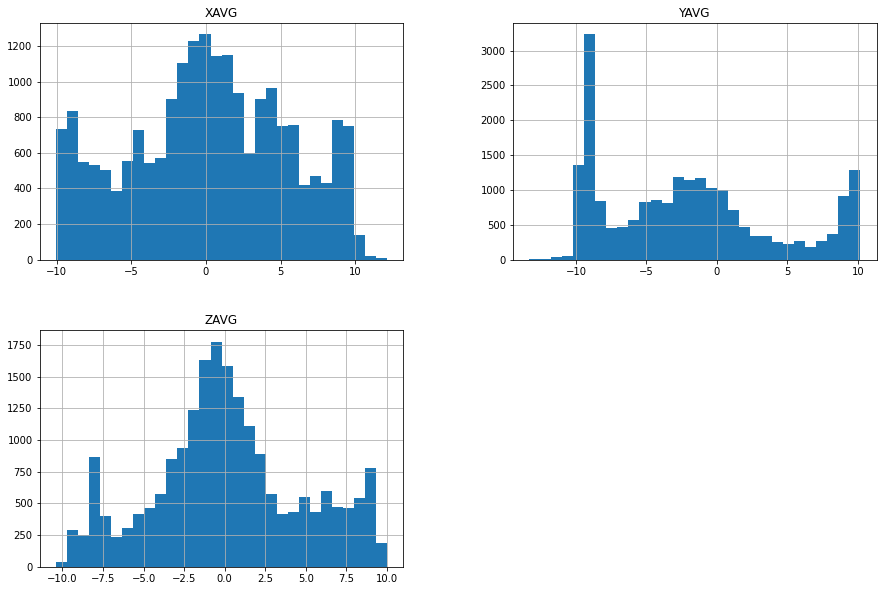

In [27]:
_ = all_phone_accel[['XAVG', 'YAVG', 'ZAVG']].hist(bins=30, figsize=(15, 10))

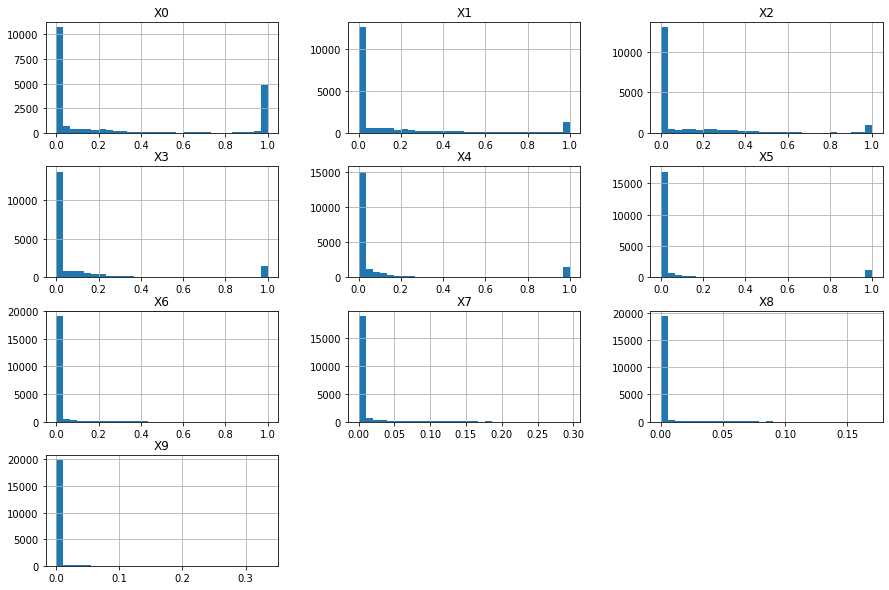

In [28]:
_ = all_phone_accel[['X0', 'X1', 'X2', 'X3','X4','X5','X6','X7','X8','X9']].hist(bins=30, figsize=(15, 10))

/root/anaconda3/envs/exp1/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


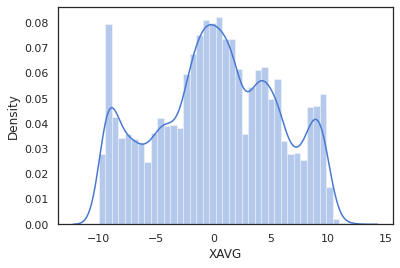

In [29]:
import seaborn as sns

sns.set(color_codes=True)
sns.set(style="white", palette="muted")
_ = sns.distplot(all_phone_accel['XAVG'])

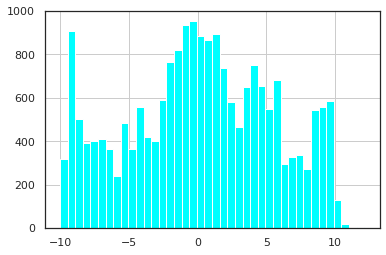

In [30]:
_ = all_phone_accel['XAVG'].hist(bins=40, color = 'cyan')

/root/anaconda3/envs/exp1/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


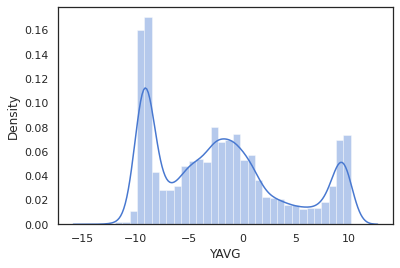

In [31]:
_ = sns.distplot(all_phone_accel['YAVG'])

/root/anaconda3/envs/exp1/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


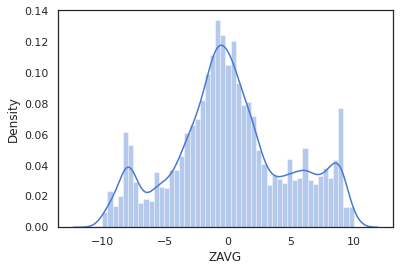

In [32]:
_ = sns.distplot(all_phone_accel['ZAVG'])

/root/anaconda3/envs/exp1/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


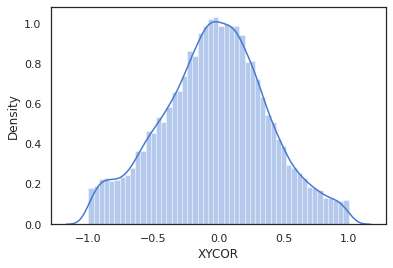

In [33]:
_ = sns.distplot(all_phone_accel['XYCOR'])

/root/anaconda3/envs/exp1/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


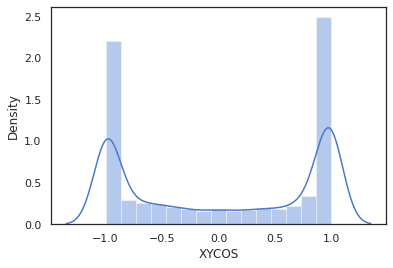

In [34]:
_ = sns.distplot(all_phone_accel['XYCOS'])

/root/anaconda3/envs/exp1/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


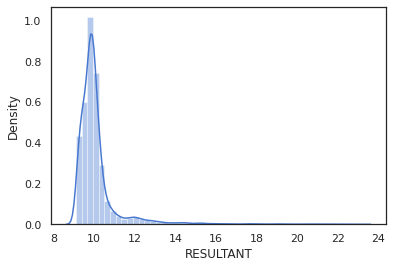

In [35]:
_ = sns.distplot(all_phone_accel['RESULTANT'])

/root/anaconda3/envs/exp1/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


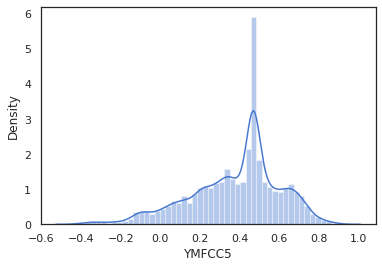

In [36]:
_ = sns.distplot(all_phone_accel['YMFCC5'])

In [37]:
all_phone_accel.drop('PARTICIPANT', axis = 1, inplace = True)


In [38]:
from sklearn.model_selection import train_test_split

y = all_phone_accel.ACTIVITY
X = all_phone_accel.drop('ACTIVITY', axis=1)

X_train, X_test, y_train, y_test = train_test_split(X, y, 
                                                    train_size = 0.75, 
                                                    test_size = 0.25,
                                                    shuffle = True, 
                                                    stratify = all_phone_accel.ACTIVITY)

In [39]:
X_train

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,ZMFCC10,ZMFCC11,ZMFCC12,XYCOS,XZCOS,YZCOS,XYCOR,XZCOR,YZCOR,RESULTANT
14134,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.0,0.0,0.0,...,0.259668,0.256645,0.253347,0.992867,0.965663,0.964067,-0.555167,0.124214,-0.206976,10.01780
477,0.295,0.265,0.180,0.175,0.055,0.020,0.010,0.0,0.0,0.0,...,0.665921,0.658168,0.649711,-0.062181,0.106891,-0.753234,0.016310,0.052567,-0.632989,12.09270
13387,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.0,0.0,0.0,...,0.381470,0.377029,0.372184,0.999648,0.999986,0.999659,-0.200127,-0.049827,-0.059253,9.75219
60,0.345,0.410,0.165,0.040,0.020,0.015,0.005,0.0,0.0,0.0,...,0.586399,0.579572,0.572125,-0.467102,0.008003,0.469875,-0.159449,0.169666,0.493227,10.01020
13553,0.005,0.440,0.555,0.000,0.000,0.000,0.000,0.0,0.0,0.0,...,0.264283,0.261206,0.257849,0.277762,-0.405715,-0.110914,-0.275231,-0.390203,0.336025,9.75366
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16576,0.000,0.995,0.005,0.000,0.000,0.000,0.000,0.0,0.0,0.0,...,0.001748,0.001727,0.001705,0.962035,0.402175,0.555858,-0.482648,-0.580134,0.510656,9.72178
15037,0.580,0.160,0.115,0.115,0.025,0.005,0.000,0.0,0.0,0.0,...,0.588873,0.582018,0.574539,0.494294,-0.025902,0.393566,0.092088,-0.394618,-0.150492,12.15490
2907,0.935,0.045,0.015,0.005,0.000,0.000,0.000,0.0,0.0,0.0,...,0.696431,0.688323,0.679478,0.932129,0.609241,0.392670,-0.028897,0.744658,-0.139286,11.48120
6708,0.000,0.000,0.085,0.880,0.035,0.000,0.000,0.0,0.0,0.0,...,0.312325,0.308689,0.304723,-0.971186,-0.755806,0.767040,0.208613,0.020145,-0.310142,9.66929


In [40]:
y_train

14134    G
477      B
13387    K
60       C
13553    S
        ..
16576    E
15037    B
2907     R
6708     O
4197     D
Name: ACTIVITY, Length: 15487, dtype: object

In [41]:
X_test

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,ZMFCC10,ZMFCC11,ZMFCC12,XYCOS,XZCOS,YZCOS,XYCOR,XZCOR,YZCOR,RESULTANT
2030,0.975,0.015,0.010,0.000,0.000,0.000,0.000,0.0,0.0,0.0,...,0.553464,0.547021,0.539991,0.738447,0.033750,-0.046619,0.061908,0.113816,-0.070371,10.44830
18761,0.000,0.020,0.930,0.050,0.000,0.000,0.000,0.0,0.0,0.0,...,0.204608,0.202226,0.199627,0.930087,-0.768850,-0.890751,-0.477658,0.377060,-0.052434,9.83977
17178,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.0,0.0,0.0,...,0.017307,0.017105,0.016885,0.971669,0.992956,0.972864,0.097803,-0.210491,0.288597,9.44135
11325,0.000,0.000,0.635,0.365,0.000,0.000,0.000,0.0,0.0,0.0,...,0.230387,0.227705,0.224779,0.972373,-0.921431,-0.975294,-0.013912,0.602185,0.502791,9.97562
7226,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.0,0.0,0.0,...,0.443992,0.438823,0.433184,-0.982328,0.988960,-0.995444,0.145446,0.298389,0.189458,9.11905
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6799,0.320,0.430,0.245,0.000,0.005,0.000,0.000,0.0,0.0,0.0,...,0.488694,0.483005,0.476798,-0.659493,0.087043,0.162157,-0.325151,0.272380,-0.077274,9.98384
9841,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.0,0.0,0.0,...,0.453787,0.448504,0.442741,-0.999310,-0.999817,0.999447,0.024644,0.331700,-0.178783,10.23330
16617,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.0,0.0,0.0,...,0.193852,0.191595,0.189133,-0.998135,-0.998401,0.995858,-0.248103,0.818865,-0.307548,9.63506
10763,0.000,0.890,0.110,0.000,0.000,0.000,0.000,0.0,0.0,0.0,...,-0.000618,-0.000611,-0.000603,-0.771478,-0.323717,0.228811,0.424910,-0.235025,-0.403221,10.15150


In [42]:
y_test

2030     M
18761    S
17178    D
11325    S
7226     G
        ..
6799     A
9841     I
16617    G
10763    S
5179     P
Name: ACTIVITY, Length: 5163, dtype: object

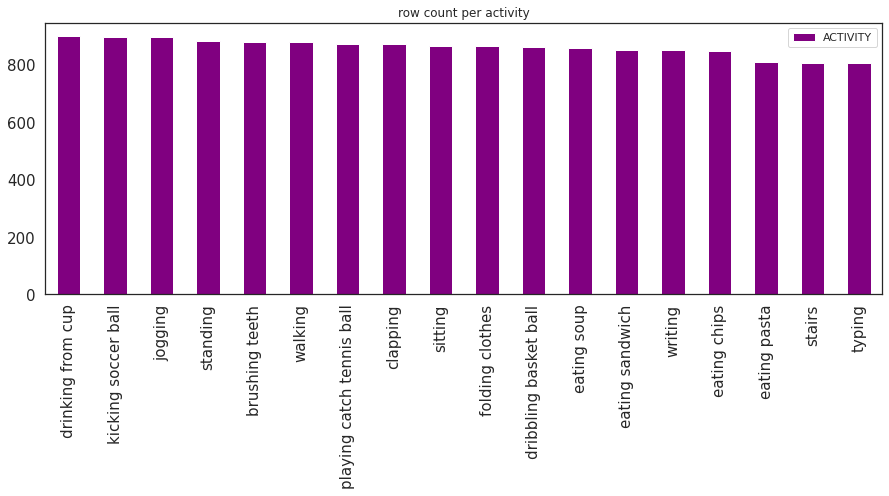

In [43]:
_ = y_train.map(activity_codes_mapping).value_counts().plot(kind = 'bar', figsize = (15,5), color = 'purple', title = 'row count per activity', legend = True, fontsize = 15)

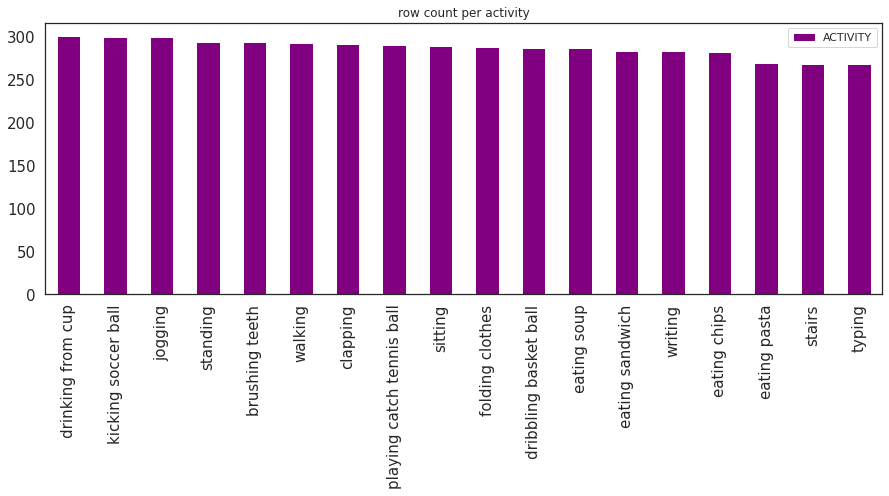

In [44]:
_ = y_test.map(activity_codes_mapping).value_counts().plot(kind = 'bar', figsize = (15,5), color = 'purple', title = 'row count per activity', legend = True, fontsize = 15)

In [45]:
X_train.insert(0, 'Y', y_train)

In [46]:
X_train

,Y,X0,X1,X2,X3,X4,X5,X6,X7,X8,...,ZMFCC10,ZMFCC11,ZMFCC12,XYCOS,XZCOS,YZCOS,XYCOR,XZCOR,YZCOR,RESULTANT
14134,G,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.0,0.0,...,0.259668,0.256645,0.253347,0.992867,0.965663,0.964067,-0.555167,0.124214,-0.206976,10.01780
477,B,0.295,0.265,0.180,0.175,0.055,0.020,0.010,0.0,0.0,...,0.665921,0.658168,0.649711,-0.062181,0.106891,-0.753234,0.016310,0.052567,-0.632989,12.09270
13387,K,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.0,0.0,...,0.381470,0.377029,0.372184,0.999648,0.999986,0.999659,-0.200127,-0.049827,-0.059253,9.75219
60,C,0.345,0.410,0.165,0.040,0.020,0.015,0.005,0.0,0.0,...,0.586399,0.579572,0.572125,-0.467102,0.008003,0.469875,-0.159449,0.169666,0.493227,10.01020
13553,S,0.005,0.440,0.555,0.000,0.000,0.000,0.000,0.0,0.0,...,0.264283,0.261206,0.257849,0.277762,-0.405715,-0.110914,-0.275231,-0.390203,0.336025,9.75366
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16576,E,0.000,0.995,0.005,0.000,0.000,0.000,0.000,0.0,0.0,...,0.001748,0.001727,0.001705,0.962035,0.402175,0.555858,-0.482648,-0.580134,0.510656,9.72178
15037,B,0.580,0.160,0.115,0.115,0.025,0.005,0.000,0.0,0.0,...,0.588873,0.582018,0.574539,0.494294,-0.025902,0.393566,0.092088,-0.394618,-0.150492,12.15490
2907,R,0.935,0.045,0.015,0.005,0.000,0.000,0.000,0.0,0.0,...,0.696431,0.688323,0.679478,0.932129,0.609241,0.392670,-0.028897,0.744658,-0.139286,11.48120
6708,O,0.000,0.000,0.085,0.880,0.035,0.000,0.000,0.0,0.0,...,0.312325,0.308689,0.304723,-0.971186,-0.755806,0.767040,0.208613,0.020145,-0.310142,9.66929


In [47]:
upper_threshold_XPEAK = X_train.XPEAK.mean() + 9*X_train.XPEAK.std()
upper_threshold_XPEAK

175.55960750644937

In [48]:
X_train.XPEAK.max()

179.0

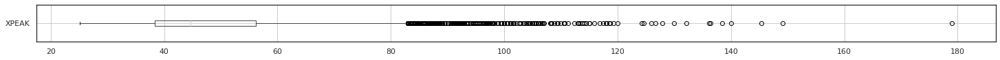

In [49]:
_ = X_train.boxplot(column=['XPEAK'], figsize=[25,1], vert=False)

In [50]:
X_train = X_train[X_train.XPEAK < upper_threshold_XPEAK].copy()

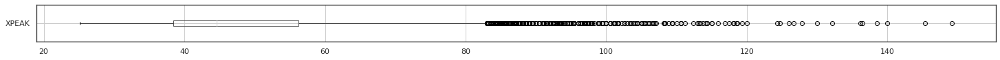

In [51]:
_ = X_train.boxplot(column=['XPEAK'], figsize=[25,1], vert=False)

In [52]:
upper_threshold_YPEAK = X_train.YPEAK.mean() + 9*X_train.YPEAK.std()
upper_threshold_YPEAK

183.68420716670326

In [53]:
X_train.YPEAK.max()

200.0

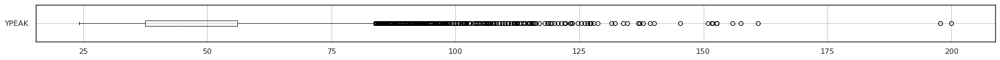

In [54]:
_ = X_train.boxplot(column=['YPEAK'], figsize=[25,1], vert=False)

In [55]:
X_train = X_train[X_train.YPEAK < upper_threshold_YPEAK].copy()

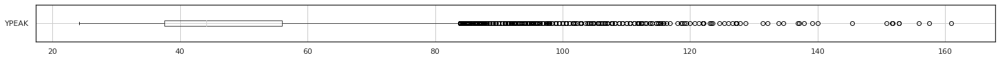

In [56]:
_ = X_train.boxplot(column=['YPEAK'], figsize=[25,1], vert=False)

In [57]:
upper_threshold_ZPEAK = X_train.ZPEAK.mean() + 9*X_train.ZPEAK.std()
upper_threshold_ZPEAK

151.0297211952583

In [58]:
X_train.ZPEAK.max()


173.0

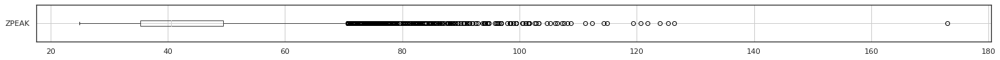

In [59]:
_ = X_train.boxplot(column=['ZPEAK'], figsize=[25,1], vert=False)

In [60]:
X_train = X_train[X_train.ZPEAK < upper_threshold_ZPEAK].copy()

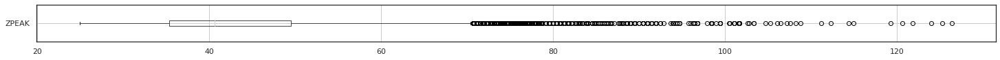

In [61]:
_ = X_train.boxplot(column=['ZPEAK'], figsize=[25,1], vert=False)

In [62]:
y_train = X_train['Y']

In [63]:
y_train

14134    G
477      B
13387    K
60       C
13553    S
        ..
16576    E
15037    B
2907     R
6708     O
4197     D
Name: Y, Length: 15483, dtype: object

In [64]:
X_train.drop(['Y'], axis = 1, inplace = True)

In [65]:
from sklearn.preprocessing import MaxAbsScaler

scaling_transformer = MaxAbsScaler().fit(X_train[['XAVG', 'YAVG', 'ZAVG', 'XPEAK', 'YPEAK', 'ZPEAK', 'XABSOLDEV', 'YABSOLDEV', 'ZABSOLDEV', 'RESULTANT']])

In [66]:
X_train[['XAVG', 'YAVG', 'ZAVG', 'XPEAK', 'YPEAK', 'ZPEAK', 'XABSOLDEV', 'YABSOLDEV', 'ZABSOLDEV', 'RESULTANT']] = scaling_transformer.transform(X_train[['XAVG', 'YAVG', 'ZAVG', 'XPEAK', 'YPEAK', 'ZPEAK', 'XABSOLDEV', 'YABSOLDEV', 'ZABSOLDEV', 'RESULTANT']])

In [67]:
X_test = X_test.copy()

In [68]:
X_test[['XAVG', 'YAVG', 'ZAVG', 'XPEAK', 'YPEAK', 'ZPEAK', 'XABSOLDEV', 'YABSOLDEV', 'ZABSOLDEV', 'RESULTANT']] = scaling_transformer.transform(X_test[['XAVG', 'YAVG', 'ZAVG', 'XPEAK', 'YPEAK', 'ZPEAK', 'XABSOLDEV', 'YABSOLDEV', 'ZABSOLDEV', 'RESULTANT']])

In [69]:
X_test

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,ZMFCC10,ZMFCC11,ZMFCC12,XYCOS,XZCOS,YZCOS,XYCOR,XZCOR,YZCOR,RESULTANT
2030,0.975,0.015,0.010,0.000,0.000,0.000,0.000,0.0,0.0,0.0,...,0.553464,0.547021,0.539991,0.738447,0.033750,-0.046619,0.061908,0.113816,-0.070371,0.451235
18761,0.000,0.020,0.930,0.050,0.000,0.000,0.000,0.0,0.0,0.0,...,0.204608,0.202226,0.199627,0.930087,-0.768850,-0.890751,-0.477658,0.377060,-0.052434,0.424954
17178,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.0,0.0,0.0,...,0.017307,0.017105,0.016885,0.971669,0.992956,0.972864,0.097803,-0.210491,0.288597,0.407747
11325,0.000,0.000,0.635,0.365,0.000,0.000,0.000,0.0,0.0,0.0,...,0.230387,0.227705,0.224779,0.972373,-0.921431,-0.975294,-0.013912,0.602185,0.502791,0.430821
7226,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.0,0.0,0.0,...,0.443992,0.438823,0.433184,-0.982328,0.988960,-0.995444,0.145446,0.298389,0.189458,0.393828
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6799,0.320,0.430,0.245,0.000,0.005,0.000,0.000,0.0,0.0,0.0,...,0.488694,0.483005,0.476798,-0.659493,0.087043,0.162157,-0.325151,0.272380,-0.077274,0.431176
9841,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.0,0.0,0.0,...,0.453787,0.448504,0.442741,-0.999310,-0.999817,0.999447,0.024644,0.331700,-0.178783,0.441950
16617,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.0,0.0,0.0,...,0.193852,0.191595,0.189133,-0.998135,-0.998401,0.995858,-0.248103,0.818865,-0.307548,0.416113
10763,0.000,0.890,0.110,0.000,0.000,0.000,0.000,0.0,0.0,0.0,...,-0.000618,-0.000611,-0.000603,-0.771478,-0.323717,0.228811,0.424910,-0.235025,-0.403221,0.438417


In [70]:
X_train.reset_index(drop = True, inplace = True)
X_train

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,ZMFCC10,ZMFCC11,ZMFCC12,XYCOS,XZCOS,YZCOS,XYCOR,XZCOR,YZCOR,RESULTANT
0,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.0,0.0,0.0,...,0.259668,0.256645,0.253347,0.992867,0.965663,0.964067,-0.555167,0.124214,-0.206976,0.432643
1,0.295,0.265,0.180,0.175,0.055,0.020,0.010,0.0,0.0,0.0,...,0.665921,0.658168,0.649711,-0.062181,0.106891,-0.753234,0.016310,0.052567,-0.632989,0.522252
2,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.0,0.0,0.0,...,0.381470,0.377029,0.372184,0.999648,0.999986,0.999659,-0.200127,-0.049827,-0.059253,0.421172
3,0.345,0.410,0.165,0.040,0.020,0.015,0.005,0.0,0.0,0.0,...,0.586399,0.579572,0.572125,-0.467102,0.008003,0.469875,-0.159449,0.169666,0.493227,0.432315
4,0.005,0.440,0.555,0.000,0.000,0.000,0.000,0.0,0.0,0.0,...,0.264283,0.261206,0.257849,0.277762,-0.405715,-0.110914,-0.275231,-0.390203,0.336025,0.421235
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15478,0.000,0.995,0.005,0.000,0.000,0.000,0.000,0.0,0.0,0.0,...,0.001748,0.001727,0.001705,0.962035,0.402175,0.555858,-0.482648,-0.580134,0.510656,0.419858
15479,0.580,0.160,0.115,0.115,0.025,0.005,0.000,0.0,0.0,0.0,...,0.588873,0.582018,0.574539,0.494294,-0.025902,0.393566,0.092088,-0.394618,-0.150492,0.524939
15480,0.935,0.045,0.015,0.005,0.000,0.000,0.000,0.0,0.0,0.0,...,0.696431,0.688323,0.679478,0.932129,0.609241,0.392670,-0.028897,0.744658,-0.139286,0.495843
15481,0.000,0.000,0.085,0.880,0.035,0.000,0.000,0.0,0.0,0.0,...,0.312325,0.308689,0.304723,-0.971186,-0.755806,0.767040,0.208613,0.020145,-0.310142,0.417592


In [71]:
X_test.reset_index(drop = True, inplace = True)
X_test

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,ZMFCC10,ZMFCC11,ZMFCC12,XYCOS,XZCOS,YZCOS,XYCOR,XZCOR,YZCOR,RESULTANT
0,0.975,0.015,0.010,0.000,0.000,0.000,0.000,0.0,0.0,0.0,...,0.553464,0.547021,0.539991,0.738447,0.033750,-0.046619,0.061908,0.113816,-0.070371,0.451235
1,0.000,0.020,0.930,0.050,0.000,0.000,0.000,0.0,0.0,0.0,...,0.204608,0.202226,0.199627,0.930087,-0.768850,-0.890751,-0.477658,0.377060,-0.052434,0.424954
2,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.0,0.0,0.0,...,0.017307,0.017105,0.016885,0.971669,0.992956,0.972864,0.097803,-0.210491,0.288597,0.407747
3,0.000,0.000,0.635,0.365,0.000,0.000,0.000,0.0,0.0,0.0,...,0.230387,0.227705,0.224779,0.972373,-0.921431,-0.975294,-0.013912,0.602185,0.502791,0.430821
4,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.0,0.0,0.0,...,0.443992,0.438823,0.433184,-0.982328,0.988960,-0.995444,0.145446,0.298389,0.189458,0.393828
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5158,0.320,0.430,0.245,0.000,0.005,0.000,0.000,0.0,0.0,0.0,...,0.488694,0.483005,0.476798,-0.659493,0.087043,0.162157,-0.325151,0.272380,-0.077274,0.431176
5159,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.0,0.0,0.0,...,0.453787,0.448504,0.442741,-0.999310,-0.999817,0.999447,0.024644,0.331700,-0.178783,0.441950
5160,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.0,0.0,0.0,...,0.193852,0.191595,0.189133,-0.998135,-0.998401,0.995858,-0.248103,0.818865,-0.307548,0.416113
5161,0.000,0.890,0.110,0.000,0.000,0.000,0.000,0.0,0.0,0.0,...,-0.000618,-0.000611,-0.000603,-0.771478,-0.323717,0.228811,0.424910,-0.235025,-0.403221,0.438417


In [72]:
y_train.reset_index(drop = True, inplace = True)
y_train

0        G
1        B
2        K
3        C
4        S
        ..
15478    E
15479    B
15480    R
15481    O
15482    D
Name: Y, Length: 15483, dtype: object

In [73]:
y_test.reset_index(drop = True, inplace = True)
y_test

0       M
1       S
2       D
3       S
4       G
       ..
5158    A
5159    I
5160    G
5161    S
5162    P
Name: ACTIVITY, Length: 5163, dtype: object

In [74]:
fn = r'./wisdm-dataset/arff_files/phone/accel/data_1623_accel_phone.arff'
par_23_df = pd.read_csv(fn, names = features, skiprows = 96, index_col=None, header=0)
par_23_df['ACT'] = par_23_df['ACTIVITY'].map(activity_codes_mapping)

In [75]:
import plotly.express as px

fig = px.scatter_3d(par_23_df, x='XAVG', y='YAVG', z='ZAVG', color ='ACT', color_discrete_map = activity_color_map)

fig.update_layout(scene = dict(
                    xaxis = dict(
                         backgroundcolor="rgb(200, 200, 230)",
                         gridcolor="white",
                         showbackground=True,
                         zerolinecolor="white",),
                    yaxis = dict(
                        backgroundcolor="rgb(230, 200,230)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white"),
                    zaxis = dict(
                        backgroundcolor="rgb(230, 230,200)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white",),),
                    height=1000,
                    width=1750,
                    margin=dict(
                    r=10, l=10,
                    b=10, t=10)
                  )


fig.show()

In [76]:
fn = r'./wisdm-dataset/arff_files/phone/accel/data_1640_accel_phone.arff'
par_40_df = pd.read_csv(fn, names = features, skiprows = 96, index_col=None, header=0)
par_40_df['ACT'] = par_40_df['ACTIVITY'].map(activity_codes_mapping)

In [77]:
import plotly.express as px

fig = px.scatter_3d(par_40_df, x='XABSOLDEV', y='YABSOLDEV', z='ZABSOLDEV', color ='ACT', color_discrete_map = activity_color_map)

fig.update_layout(scene = dict(
                    xaxis = dict(
                         backgroundcolor="rgb(200, 200, 230)",
                         gridcolor="white",
                         showbackground=True,
                         zerolinecolor="white",),
                    yaxis = dict(
                        backgroundcolor="rgb(230, 200,230)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white"),
                    zaxis = dict(
                        backgroundcolor="rgb(230, 230,200)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white",),),
                    height=1000,
                    width=1750,
                    margin=dict(
                    r=10, l=10,
                    b=10, t=10)
                  )


fig.show()

In [78]:
fn = r'./wisdm-dataset/arff_files/phone/accel/data_1635_accel_phone.arff'
par_35_df = pd.read_csv(fn, names = features, skiprows = 96, index_col=None, header=0)
par_35_df['ACT'] = par_35_df['ACTIVITY'].map(activity_codes_mapping)

In [79]:
import plotly.express as px

fig = px.scatter_3d(par_35_df, x='XMFCC7', y='YMFCC7', z='ZMFCC7', color ='ACT', color_discrete_map = activity_color_map)

fig.update_layout(scene = dict(
                    xaxis = dict(
                         backgroundcolor="rgb(200, 200, 230)",
                         gridcolor="white",
                         showbackground=True,
                         zerolinecolor="white",),
                    yaxis = dict(
                        backgroundcolor="rgb(230, 200,230)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white"),
                    zaxis = dict(
                        backgroundcolor="rgb(230, 230,200)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white",),),
                    height = 1000,
                    width=1750,
                    margin=dict(
                    r=10, l=10,
                    b=10, t=10)
                  )


fig.show()

In [80]:
fn = r'./wisdm-dataset/arff_files/phone/accel/data_1640_accel_phone.arff'
par_0_df = pd.read_csv(fn, names = features, skiprows = 96, index_col=None, header=0)
par_0_df['ACT'] = par_0_df['ACTIVITY'].map(activity_codes_mapping)

In [81]:
import plotly.express as px

fig = px.scatter_3d(par_0_df, x='X5', y='Y5', z='Z5', color ='ACT', color_discrete_map = activity_color_map)

fig.update_layout(scene = dict(
                    xaxis = dict(
                         backgroundcolor="rgb(200, 200, 230)",
                         gridcolor="white",
                         showbackground=True,
                         zerolinecolor="white",),
                    yaxis = dict(
                        backgroundcolor="rgb(230, 200,230)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white"),
                    zaxis = dict(
                        backgroundcolor="rgb(230, 230,200)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white",),),
                    height=1000,
                    width=1750,
                    margin=dict(
                    r=10, l=10,
                    b=10, t=10)
                  )


fig.show()

In [82]:
import plotly.express as px

fig = px.scatter_3d(par_0_df, x='XAVG', y='YAVG', z='ZAVG', color ='ACT', color_discrete_map = activity_color_map)

fig.update_layout(scene = dict(
                    xaxis = dict(
                         backgroundcolor="rgb(200, 200, 230)",
                         gridcolor="white",
                         showbackground=True,
                         zerolinecolor="white",),
                    yaxis = dict(
                        backgroundcolor="rgb(230, 200,230)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white"),
                    zaxis = dict(
                        backgroundcolor="rgb(230, 230,200)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white",),),
                    height=1000,
                    width=1750,
                    margin=dict(
                    r=10, l=10,
                    b=10, t=10)
                  )


fig.show()

In [83]:
import plotly.express as px

all_pa = all_phone_accel.copy()
all_pa['ACT'] = all_pa['ACTIVITY'].map(activity_codes_mapping)

fig = px.scatter_3d(all_pa, x='XAVG', y='YAVG', z='ZAVG', color ='ACT', color_discrete_map = activity_color_map)

fig.update_layout(scene = dict(
                    xaxis = dict(
                         backgroundcolor="rgb(200, 200, 230)",
                         gridcolor="white",
                         showbackground=True,
                         zerolinecolor="white",),
                    yaxis = dict(
                        backgroundcolor="rgb(230, 200,230)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white"),
                    zaxis = dict(
                        backgroundcolor="rgb(230, 230,200)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white",),),
                    width=1800,
                    height = 1000,
                    margin=dict(
                    r=10, l=10,
                    b=10, t=10)
                  )


fig.show()


In [84]:
import plotly.express as px

fig = px.scatter_3d(all_pa, x='XMFCC7', y='YMFCC7', z='ZMFCC7', color ='ACT', color_discrete_map = activity_color_map)

fig.update_layout(scene = dict(
                    xaxis = dict(
                         backgroundcolor="rgb(200, 200, 230)",
                         gridcolor="white",
                         showbackground=True,
                         zerolinecolor="white",),
                    yaxis = dict(
                        backgroundcolor="rgb(230, 200,230)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white"),
                    zaxis = dict(
                        backgroundcolor="rgb(230, 230,200)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white",),),
                    width=1800,
                    height = 1000,
                    margin=dict(
                    r=10, l=10,
                    b=10, t=10)
                  )

fig.show()

In [85]:
from matplotlib import pyplot as plt
from sklearn.manifold import TSNE

def plot_tSNE(X, y, fig_size):
    tsne = TSNE(n_components=2, random_state=300)
    X_2d = tsne.fit_transform(X)
    target_ids = ('A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'O', 'P', 'Q', 'R', 'S' )

    plt.figure(figsize=(fig_size, fig_size))
    colors = 'lime', 'red', 'blue', 'orange', 'yellow', 'lightgreen', 'greenyellow', 'magenta', 'gold', 'cyan', 'purple', 'lightgreen', 'violet', 'limegreen', 'deepskyblue', 'mediumspringgreen', 'plum', 'olive'

    for i, c, label in zip(target_ids, colors, tuple(activity_codes_mapping.values())):
        plt.scatter(X_2d[y == i, 0], X_2d[y == i, 1], c=c, label=label)

    plt.legend()
    plt.show()

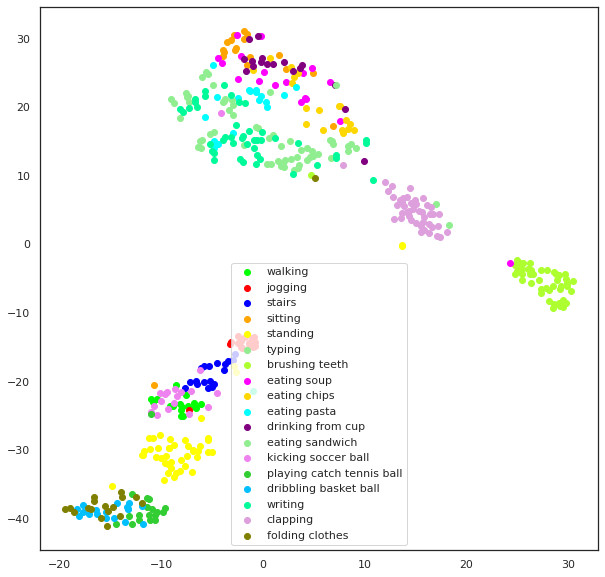

In [86]:
yy = par_23_df.ACTIVITY
XX = par_23_df.drop(['ACTIVITY','PARTICIPANT','ACT','XSTANDDEV','YSTANDDEV','ZSTANDDEV','XVAR','YVAR','ZVAR'], axis = 1)
plot_tSNE(XX, yy, 10)

In [90]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from time import time

from sklearn.metrics import log_loss
from sklearn.tree import DecisionTreeClassifier, export_graphviz

from sklearn.model_selection import train_test_split, GridSearchCV

from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.metrics import accuracy_score
from sklearn.tree import DecisionTreeClassifier
import warnings


import pydot
from IPython.display import Image
from six import StringIO
from sklearn.tree import export_graphviz

In [93]:
def visualize_tree(model, md=5, width=800):
    dot_data = StringIO()  
    export_graphviz(model, out_file=dot_data, feature_names=X_train.columns, max_depth=md)
    graph = pydot.graph_from_dot_data(dot_data.getvalue())[0]  
    return Image(graph.create_png(), width=width) 

In [94]:
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import StratifiedShuffleSplit
from sklearn.model_selection import GroupKFold

my_cv = StratifiedShuffleSplit(n_splits=5, train_size=0.7, test_size=0.3)

In [95]:
dt_classifier = DecisionTreeClassifier()

In [96]:
my_param_grid = {'min_samples_leaf': [6, 10, 20, 40],
                 'min_weight_fraction_leaf': [0.01, 0.02, 0.05],
                 'criterion': ['entropy'],
                 'min_impurity_decrease': [1e-2, 7e-3]}

In [97]:
dt_model_gs = GridSearchCV(estimator=dt_classifier, 
                           param_grid=my_param_grid, 
                           cv=my_cv, 
                           scoring='accuracy',
                           verbose = 0,
                           return_train_score = True)

In [98]:
dt_model_gs.fit(X_train, y_train)

GridSearchCV(cv=StratifiedShuffleSplit(n_splits=5, random_state=None, test_size=0.3,
            train_size=0.7),
             estimator=DecisionTreeClassifier(),
             param_grid={'criterion': ['entropy'],
                         'min_impurity_decrease': [0.01, 0.007],
                         'min_samples_leaf': [6, 10, 20, 40],
                         'min_weight_fraction_leaf': [0.01, 0.02, 0.05]},
             return_train_score=True, scoring='accuracy')

In [99]:
dt_model_gs.best_params_

{'criterion': 'entropy',
 'min_impurity_decrease': 0.007,
 'min_samples_leaf': 6,
 'min_weight_fraction_leaf': 0.01}

In [100]:
dt_best_classifier = dt_model_gs.best_estimator_


In [101]:
dt_model_gs.cv_results_

{'mean_fit_time': array([1.48906035, 1.24689479, 0.87108936, 1.46378322, 1.26405993,
        0.86282916, 1.49753947, 1.24742856, 0.86178484, 1.45531812,
        1.26898084, 0.85819721, 1.56798759, 1.29832592, 0.86600013,
        1.56033821, 1.27030735, 0.85669556, 1.55570216, 1.28148942,
        0.84962149, 1.56358051, 1.26539974, 0.85017729]),
 'std_fit_time': array([0.04096254, 0.0117866 , 0.009157  , 0.01622531, 0.00586857,
        0.01889215, 0.03935341, 0.01808444, 0.02507066, 0.01201059,
        0.02043928, 0.01746042, 0.04216699, 0.02698999, 0.02382186,
        0.01782562, 0.01250125, 0.00475092, 0.02728269, 0.01109957,
        0.0062987 , 0.03397065, 0.01636965, 0.01810842]),
 'mean_score_time': array([0.00921955, 0.00847945, 0.00842099, 0.00865741, 0.00835724,
        0.00898361, 0.00861154, 0.00900264, 0.00847721, 0.00899234,
        0.00898318, 0.00882149, 0.00951219, 0.00872011, 0.00852695,
        0.00865793, 0.00840158, 0.00894337, 0.00904584, 0.00897503,
        0.009234

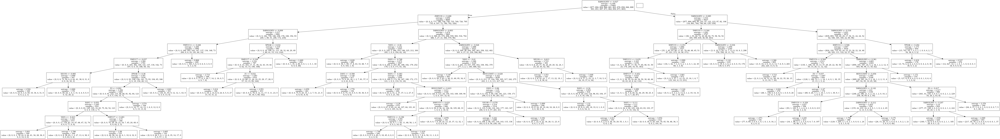

In [102]:
visualize_tree(dt_best_classifier, md=20, width=2000)

In [103]:
dt_best_classifier.get_params()

{'ccp_alpha': 0.0,
 'class_weight': None,
 'criterion': 'entropy',
 'max_depth': None,
 'max_features': None,
 'max_leaf_nodes': None,
 'min_impurity_decrease': 0.007,
 'min_impurity_split': None,
 'min_samples_leaf': 6,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.01,
 'random_state': None,
 'splitter': 'best'}

In [104]:
dt_best_classifier.get_depth()

9

In [105]:
dt_best_classifier.get_n_leaves()

49

In [106]:
scores = cross_val_score(dt_best_classifier, X_train, y_train, cv=my_cv, scoring='accuracy')
list(scores)

[0.35177610333692144,
 0.33821313240043055,
 0.35888051668460713,
 0.34079655543595266,
 0.3528525296017223]

In [107]:
dt_best_classifier.score(X_train, y_train)

0.3544532713298456

In [108]:
y_train_pred = dt_best_classifier.predict(X_train)

In [109]:
accuracy_score(y_true=y_train, y_pred=y_train_pred)

0.3544532713298456

In [110]:
log_loss(y_train, dt_best_classifier.predict_proba(X_train))

1.7942859222827954

In [111]:
y_test

0       M
1       S
2       D
3       S
4       G
       ..
5158    A
5159    I
5160    G
5161    S
5162    P
Name: ACTIVITY, Length: 5163, dtype: object

In [112]:
y_test_pred = dt_best_classifier.predict(X_test)
print(pd.DataFrame(y_test_pred))

      0
0     C
1     S
2     D
3     S
4     I
...  ..
5158  C
5159  G
5160  E
5161  G
5162  M

[5163 rows x 1 columns]


In [113]:
cm = confusion_matrix(y_true=y_test,
                      y_pred=y_test_pred)
#                      y_pred=y_test_pred, normalize = 'true')
    
cm_act = pd.DataFrame(cm,
                      index=dt_best_classifier.classes_,
                      columns=dt_best_classifier.classes_)

cm_act.columns = activity_codes_mapping.values()
cm_act.index = activity_codes_mapping.values()
cm_act

,walking,jogging,stairs,sitting,standing,typing,brushing teeth,eating soup,eating chips,eating pasta,drinking from cup,eating sandwich,kicking soccer ball,playing catch tennis ball,dribbling basket ball,writing,clapping,folding clothes
walking,126,5,80,0,0,0,0,0,0,0,2,0,63,0,6,0,0,10
jogging,10,272,3,0,0,0,0,0,0,0,0,0,5,0,0,0,1,8
stairs,60,12,129,0,0,0,0,0,0,0,0,0,48,0,13,0,0,6
sitting,0,2,1,80,8,0,20,11,45,5,12,11,2,0,1,35,42,14
standing,0,1,2,10,172,14,13,0,0,0,8,5,1,7,0,13,9,39
typing,1,1,1,40,34,47,14,3,29,7,30,3,4,0,1,21,21,11
brushing teeth,0,0,0,3,44,8,92,0,22,6,11,5,4,3,0,20,50,26
eating soup,0,0,0,14,17,2,28,41,40,3,37,2,0,0,0,19,50,33
eating chips,4,1,0,24,27,10,22,3,61,5,37,0,1,1,1,13,48,24
eating pasta,3,0,1,20,33,5,12,33,34,7,31,2,1,1,0,18,51,17


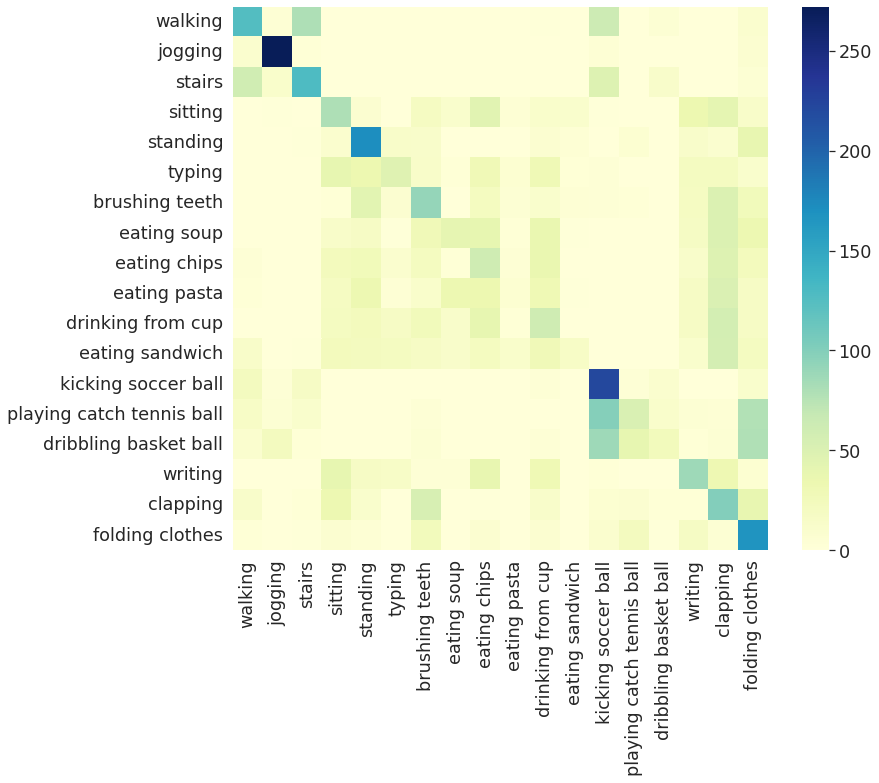

In [114]:
sns.set(font_scale=1.6)
fig, ax = plt.subplots(figsize=(12,10))  
_ = sns.heatmap(cm_act, cmap="YlGnBu")

In [115]:
sns.set(font_scale=1.2)

In [116]:
accuracy_per_activity = pd.DataFrame([cm_act.iloc[i][i]/np.sum(cm_act.iloc[i]) for i in range(18)],index=activity_codes_mapping.values())
accuracy_per_activity

,0
walking,0.431507
jogging,0.909699
stairs,0.481343
sitting,0.276817
standing,0.585034
typing,0.175373
brushing teeth,0.312925
eating soup,0.143357
eating chips,0.216312
eating pasta,0.026022


In [117]:
print(classification_report(y_true=y_test,
                            y_pred=y_test_pred))

              precision    recall  f1-score   support

           A       0.44      0.43      0.44       292
           B       0.83      0.91      0.87       299
           C       0.50      0.48      0.49       268
           D       0.25      0.28      0.26       289
           E       0.41      0.59      0.49       294
           F       0.33      0.18      0.23       268
           G       0.27      0.31      0.29       294
           H       0.34      0.14      0.20       286
           I       0.18      0.22      0.20       282
           J       0.15      0.03      0.04       269
           K       0.19      0.20      0.20       301
           L       0.36      0.06      0.10       283
           M       0.40      0.74      0.52       299
           O       0.38      0.18      0.25       290
           P       0.33      0.09      0.14       287
           Q       0.31      0.31      0.31       283
           R       0.19      0.34      0.24       291
           S       0.27    

In [118]:
accuracy_score(y_true=y_test, y_pred=y_test_pred)

0.3406933953128026

In [119]:
log_loss(y_test, dt_best_classifier.predict_proba(X_test))

2.1115152778120025

In [120]:
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import StratifiedShuffleSplit
from sklearn.model_selection import GroupKFold
from sklearn.ensemble import RandomForestClassifier

In [121]:
rf_classifier = RandomForestClassifier(**dt_model_gs.best_params_)

In [122]:
my_param_grid = {'bootstrap': [True], 
                 'n_estimators': [50, 100, 200], 
                 'oob_score': [True, False], 
                 'warm_start': [True, False]}

In [123]:
rf_model_gs = GridSearchCV(estimator = rf_classifier, 
                           param_grid = my_param_grid, 
                           scoring = 'accuracy',
                           cv = my_cv)

In [124]:
rf_model_gs.fit(X_train, y_train)

GridSearchCV(cv=StratifiedShuffleSplit(n_splits=5, random_state=None, test_size=0.3,
            train_size=0.7),
             estimator=RandomForestClassifier(criterion='entropy',
                                              min_impurity_decrease=0.007,
                                              min_samples_leaf=6,
                                              min_weight_fraction_leaf=0.01),
             param_grid={'bootstrap': [True], 'n_estimators': [50, 100, 200],
                         'oob_score': [True, False],
                         'warm_start': [True, False]},
             scoring='accuracy')

In [125]:
rf_best_classifier = rf_model_gs.best_estimator_

In [126]:
rf_model_gs.cv_results_

{'mean_fit_time': array([ 5.54045625,  5.42877932,  5.34986982,  5.41517076, 10.91607275,
        10.82045269, 10.65471158, 10.71467195, 21.65363765, 21.68311405,
        21.40611525, 21.44217062]),
 'std_fit_time': array([0.07906953, 0.0711711 , 0.02923719, 0.103564  , 0.17028939,
        0.06050613, 0.06331827, 0.15115043, 0.07465382, 0.0772189 ,
        0.17317053, 0.16623514]),
 'mean_score_time': array([0.05119529, 0.05080972, 0.05109229, 0.05267954, 0.09212599,
        0.09410644, 0.09508204, 0.09585671, 0.17767081, 0.17809553,
        0.18047619, 0.18026285]),
 'std_score_time': array([0.00128345, 0.00056844, 0.00059431, 0.0017246 , 0.00032828,
        0.00101788, 0.00247669, 0.00414883, 0.00315653, 0.0037601 ,
        0.00372883, 0.00258661]),
 'param_bootstrap': masked_array(data=[True, True, True, True, True, True, True, True, True,
                    True, True, True],
              mask=[False, False, False, False, False, False, False, False,
                    False, Fal

In [127]:
rf_best_classifier.get_params()

{'bootstrap': True,
 'ccp_alpha': 0.0,
 'class_weight': None,
 'criterion': 'entropy',
 'max_depth': None,
 'max_features': 'auto',
 'max_leaf_nodes': None,
 'max_samples': None,
 'min_impurity_decrease': 0.007,
 'min_impurity_split': None,
 'min_samples_leaf': 6,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.01,
 'n_estimators': 100,
 'n_jobs': None,
 'oob_score': False,
 'random_state': None,
 'verbose': 0,
 'warm_start': True}

In [128]:
scores = cross_val_score(rf_best_classifier, X_train, y_train, cv=my_cv, scoring='accuracy')
list(scores)

[0.4658772874058127,
 0.46846071044133475,
 0.4628632938643703,
 0.45984930032292787,
 0.47082884822389665]

In [129]:
y_train_pred = rf_best_classifier.predict(X_train)
#print(pd.DataFrame(y_train_pred))

In [130]:
accuracy_score(y_true=y_train, y_pred=y_train_pred)

0.4701285280630369

In [131]:
log_loss(y_train, dt_best_classifier.predict_proba(X_train))

1.7942859222827954

In [132]:
y_test

0       M
1       S
2       D
3       S
4       G
       ..
5158    A
5159    I
5160    G
5161    S
5162    P
Name: ACTIVITY, Length: 5163, dtype: object

In [133]:
y_test_pred = rf_best_classifier.predict(X_test)
print(pd.DataFrame(y_test_pred))

      0
0     C
1     S
2     D
3     S
4     I
...  ..
5158  C
5159  K
5160  E
5161  O
5162  M

[5163 rows x 1 columns]


In [134]:
cm = confusion_matrix(y_true=y_test,
                      y_pred=y_test_pred)
    
cm_act = pd.DataFrame(cm,
                      index=rf_best_classifier.classes_,
                      columns=rf_best_classifier.classes_)

cm_act.columns = activity_codes_mapping.values()
cm_act.index = activity_codes_mapping.values()
cm_act

,walking,jogging,stairs,sitting,standing,typing,brushing teeth,eating soup,eating chips,eating pasta,drinking from cup,eating sandwich,kicking soccer ball,playing catch tennis ball,dribbling basket ball,writing,clapping,folding clothes
walking,159,26,77,0,0,0,0,0,0,0,0,0,28,0,0,0,0,2
jogging,18,270,6,0,0,0,0,0,0,0,2,0,2,0,0,0,0,1
stairs,67,17,143,0,0,0,0,0,0,0,0,0,32,2,6,0,0,1
sitting,2,1,2,93,26,2,9,5,15,2,63,3,2,0,0,28,25,11
standing,1,0,1,0,213,2,2,0,12,1,2,3,4,9,6,0,0,38
typing,1,0,1,7,44,85,4,3,18,2,28,2,4,3,2,28,23,13
brushing teeth,1,0,0,7,49,2,102,1,6,7,22,0,11,3,4,18,34,27
eating soup,1,0,0,26,20,15,27,40,6,11,60,15,1,1,2,12,17,32
eating chips,0,1,0,7,41,7,16,2,86,12,24,3,9,1,3,23,22,25
eating pasta,0,0,0,30,35,7,1,14,8,72,30,1,3,1,2,15,26,24


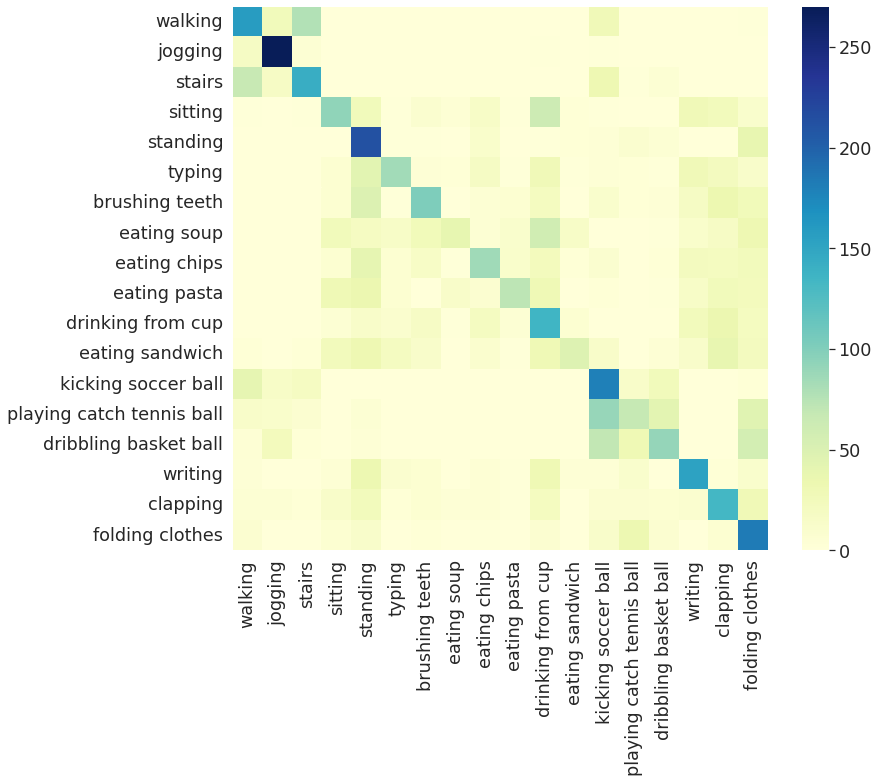

In [135]:
sns.set(font_scale=1.6)
fig, ax = plt.subplots(figsize=(12,10))
_ = sns.heatmap(cm_act, cmap="YlGnBu")

In [136]:
sns.set(font_scale=1.2)

In [137]:
accuracy_per_activity = pd.DataFrame([cm_act.iloc[i][i]/np.sum(cm_act.iloc[i]) for i in range(18)],index=activity_codes_mapping.values())
accuracy_per_activity

,0
walking,0.544521
jogging,0.903010
stairs,0.533582
sitting,0.321799
standing,0.724490
typing,0.317164
brushing teeth,0.346939
eating soup,0.139860
eating chips,0.304965
eating pasta,0.267658


In [138]:
print(classification_report(y_true=y_test,
                            y_pred=y_test_pred))

              precision    recall  f1-score   support

           A       0.48      0.54      0.51       292
           B       0.72      0.90      0.80       299
           C       0.54      0.53      0.53       268
           D       0.41      0.32      0.36       289
           E       0.38      0.72      0.50       294
           F       0.52      0.32      0.39       268
           G       0.49      0.35      0.40       294
           H       0.56      0.14      0.22       286
           I       0.44      0.30      0.36       282
           J       0.60      0.27      0.37       269
           K       0.29      0.45      0.36       301
           L       0.56      0.17      0.26       283
           M       0.38      0.60      0.46       299
           O       0.37      0.23      0.29       290
           P       0.44      0.32      0.37       287
           Q       0.47      0.54      0.50       283
           R       0.36      0.46      0.40       291
           S       0.33    

In [139]:
accuracy_score(y_true=y_test, y_pred=y_test_pred)

0.4365678868874685

In [140]:
log_loss(y_test, dt_best_classifier.predict_proba(X_test))

2.1115152778120025

In [141]:
from sklearn.linear_model import LogisticRegression
import warnings

warnings.filterwarnings('ignore')

In [142]:
lr_classifier = LogisticRegression(verbose = 0)

In [143]:
my_param_grid = {'C': [10, 50, 100, 200]}

In [144]:
lr_model_gs = GridSearchCV(estimator=lr_classifier, 
                           param_grid=my_param_grid, 
                           cv=my_cv, 
                           scoring = 'accuracy')

In [145]:
lr_model_gs.fit(X_train, y_train)

GridSearchCV(cv=StratifiedShuffleSplit(n_splits=5, random_state=None, test_size=0.3,
            train_size=0.7),
             estimator=LogisticRegression(),
             param_grid={'C': [10, 50, 100, 200]}, scoring='accuracy')

In [146]:
lr_best_classifier = lr_model_gs.best_estimator_

In [147]:
lr_model_gs.cv_results_

{'mean_fit_time': array([1.2115262 , 1.2258883 , 1.18472586, 1.23597164]),
 'std_fit_time': array([0.02294196, 0.04358686, 0.01871367, 0.04448662]),
 'mean_score_time': array([0.00917082, 0.01094666, 0.0088747 , 0.00950656]),
 'std_score_time': array([0.00030415, 0.00209881, 0.0003131 , 0.0002442 ]),
 'param_C': masked_array(data=[10, 50, 100, 200],
              mask=[False, False, False, False],
        fill_value='?',
             dtype=object),
 'params': [{'C': 10}, {'C': 50}, {'C': 100}, {'C': 200}],
 'split0_test_score': array([0.37007535, 0.37308934, 0.36663079, 0.37244349]),
 'split1_test_score': array([0.36275565, 0.36124865, 0.35974166, 0.35823466]),
 'split2_test_score': array([0.37330463, 0.37588805, 0.37308934, 0.37674919]),
 'split3_test_score': array([0.37265877, 0.36964478, 0.37308934, 0.37007535]),
 'split4_test_score': array([0.36749193, 0.36749193, 0.36512379, 0.36318622]),
 'mean_test_score': array([0.36925727, 0.36947255, 0.36753498, 0.36813778]),
 'std_test_score

In [148]:
lr_best_classifier.get_params()

{'C': 50,
 'class_weight': None,
 'dual': False,
 'fit_intercept': True,
 'intercept_scaling': 1,
 'l1_ratio': None,
 'max_iter': 100,
 'multi_class': 'auto',
 'n_jobs': None,
 'penalty': 'l2',
 'random_state': None,
 'solver': 'lbfgs',
 'tol': 0.0001,
 'verbose': 0,
 'warm_start': False}

In [149]:
scores = cross_val_score(lr_best_classifier, X_train, y_train, cv=my_cv, scoring='accuracy')
list(scores)

[0.36318622174381054,
 0.3827771797631862,
 0.3618945102260495,
 0.36835306781485466,
 0.36017222820236816]

In [150]:
y_train_pred=lr_best_classifier.predict(X_train)

In [151]:
accuracy_score(y_true=y_train, y_pred=y_train_pred)

0.3840986888845831

In [152]:
log_loss(y_train, lr_best_classifier.predict_proba(X_train))

1.838459223178652

In [153]:
y_test

0       M
1       S
2       D
3       S
4       G
       ..
5158    A
5159    I
5160    G
5161    S
5162    P
Name: ACTIVITY, Length: 5163, dtype: object

In [154]:
y_test_pred = lr_best_classifier.predict(X_test)
print(pd.DataFrame(y_test_pred))

      0
0     C
1     S
2     E
3     E
4     G
...  ..
5158  A
5159  K
5160  G
5161  S
5162  P

[5163 rows x 1 columns]


In [155]:
cm = confusion_matrix(y_true=y_test,
                      y_pred=y_test_pred)
    
cm_act = pd.DataFrame(cm,
                      index=lr_best_classifier.classes_,
                      columns=lr_best_classifier.classes_)

cm_act.columns = activity_codes_mapping.values()
cm_act.index = activity_codes_mapping.values()
cm_act

,walking,jogging,stairs,sitting,standing,typing,brushing teeth,eating soup,eating chips,eating pasta,drinking from cup,eating sandwich,kicking soccer ball,playing catch tennis ball,dribbling basket ball,writing,clapping,folding clothes
walking,203,5,55,0,0,0,0,0,0,0,1,0,18,2,5,0,3,0
jogging,12,273,7,3,0,0,0,0,0,0,0,0,2,1,1,0,0,0
stairs,32,11,153,0,0,0,1,0,0,0,0,1,40,4,20,0,5,1
sitting,0,2,5,96,20,11,15,18,11,13,21,23,0,0,0,30,19,5
standing,0,0,1,0,192,9,14,3,9,1,0,5,0,6,13,12,7,22
typing,0,1,0,6,43,50,20,10,35,11,41,7,0,4,1,23,7,9
brushing teeth,0,0,2,20,27,7,88,12,3,15,23,8,0,12,9,20,21,27
eating soup,1,0,1,17,30,17,27,41,23,15,37,25,0,0,0,14,26,12
eating chips,0,1,0,17,21,23,30,15,78,19,25,12,0,1,1,7,21,11
eating pasta,0,0,0,22,22,32,20,36,18,17,40,19,0,2,0,22,13,6


<AxesSubplot:>

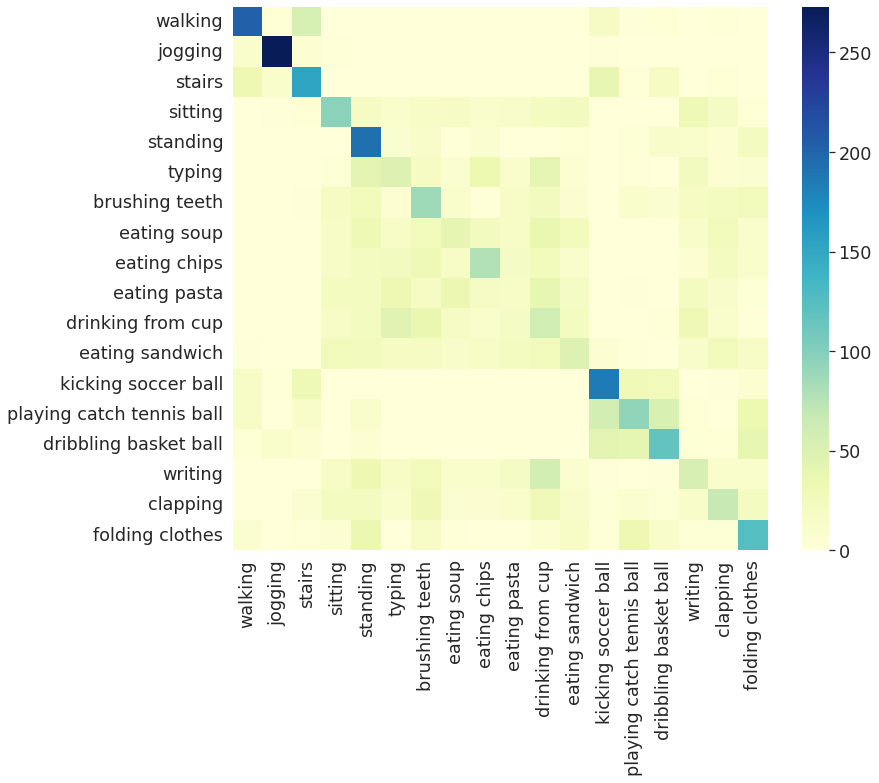

In [156]:
sns.set(font_scale=1.6)
fig, ax = plt.subplots(figsize=(12,10))
sns.heatmap(cm_act, cmap="YlGnBu")

In [157]:
sns.set(font_scale=1.2)

In [158]:
accuracy_per_activity = pd.DataFrame([cm_act.iloc[i][i]/np.sum(cm_act.iloc[i]) for i in range(18)],index=activity_codes_mapping.values())
accuracy_per_activity

,0
walking,0.695205
jogging,0.913043
stairs,0.570896
sitting,0.332180
standing,0.653061
typing,0.186567
brushing teeth,0.299320
eating soup,0.143357
eating chips,0.276596
eating pasta,0.063197


In [159]:
print(classification_report(y_true=y_test,
                            y_pred=y_test_pred))

              precision    recall  f1-score   support

           A       0.69      0.70      0.69       292
           B       0.88      0.91      0.90       299
           C       0.53      0.57      0.55       268
           D       0.36      0.33      0.34       289
           E       0.38      0.65      0.48       294
           F       0.21      0.19      0.20       268
           G       0.25      0.30      0.27       294
           H       0.22      0.14      0.17       286
           I       0.34      0.28      0.31       282
           J       0.11      0.06      0.08       269
           K       0.16      0.20      0.18       301
           L       0.23      0.17      0.20       283
           M       0.51      0.62      0.56       299
           O       0.38      0.32      0.35       290
           P       0.43      0.41      0.42       287
           Q       0.21      0.19      0.20       283
           R       0.27      0.23      0.25       291
           S       0.35    

In [160]:
accuracy_score(y_true=y_test, y_pred=y_test_pred)

0.3765252760023242

In [161]:
log_loss(y_test, lr_best_classifier.predict_proba(X_test))

1.8896348421864761

In [162]:
from sklearn.neighbors import KNeighborsClassifier

In [163]:
knn_classifier = KNeighborsClassifier()

In [164]:
my_param_grid = {'n_neighbors': [5, 10, 20], 'leaf_size': [20, 30, 40]}

In [165]:
knn_model_gs = GridSearchCV(estimator = knn_classifier, 
                            param_grid = my_param_grid,
                            cv = my_cv, 
                            scoring ='accuracy')

In [166]:
knn_model_gs.fit(X_train, y_train)

GridSearchCV(cv=StratifiedShuffleSplit(n_splits=5, random_state=None, test_size=0.3,
            train_size=0.7),
             estimator=KNeighborsClassifier(),
             param_grid={'leaf_size': [20, 30, 40], 'n_neighbors': [5, 10, 20]},
             scoring='accuracy')

In [167]:
knn_best_classifier = knn_model_gs.best_estimator_

In [168]:
print(knn_model_gs.best_params_)

{'leaf_size': 20, 'n_neighbors': 5}


In [169]:
knn_model_gs.cv_results_

{'mean_fit_time': array([0.02323437, 0.02061644, 0.02044344, 0.01971149, 0.01936636,
        0.01957607, 0.02048793, 0.02082167, 0.01997714]),
 'std_fit_time': array([0.00630486, 0.00086703, 0.00137281, 0.0003014 , 0.00059635,
        0.00094656, 0.00152009, 0.00188147, 0.00218481]),
 'mean_score_time': array([1.26422462, 1.19977942, 1.18191557, 1.16184025, 1.18560719,
        1.20574241, 1.23869519, 1.21504874, 1.24220953]),
 'std_score_time': array([0.11553006, 0.06651528, 0.04475264, 0.04109856, 0.02947599,
        0.03796706, 0.05480013, 0.04772814, 0.07991525]),
 'param_leaf_size': masked_array(data=[20, 20, 20, 30, 30, 30, 40, 40, 40],
              mask=[False, False, False, False, False, False, False, False,
                    False],
        fill_value='?',
             dtype=object),
 'param_n_neighbors': masked_array(data=[5, 10, 20, 5, 10, 20, 5, 10, 20],
              mask=[False, False, False, False, False, False, False, False,
                    False],
        fill_va

In [170]:
knn_best_classifier.get_params()

{'algorithm': 'auto',
 'leaf_size': 20,
 'metric': 'minkowski',
 'metric_params': None,
 'n_jobs': None,
 'n_neighbors': 5,
 'p': 2,
 'weights': 'uniform'}

In [171]:
scores = cross_val_score(knn_best_classifier, X_train, y_train, cv=my_cv, scoring='accuracy')
list(scores)

[0.7319698600645855,
 0.7423035522066739,
 0.7371367061356298,
 0.7395048439181916,
 0.7373519913885899]

In [172]:
y_train_pred=knn_best_classifier.predict(X_train)

In [173]:
accuracy_score(y_true=y_train, y_pred=y_train_pred)

0.8431828457017374

In [174]:
y_test_pred = knn_best_classifier.predict(X_test)

In [175]:
cm = confusion_matrix(y_true=y_test,
                      y_pred=y_test_pred)
    
cm_act = pd.DataFrame(cm,
                      index = knn_best_classifier.classes_,
                      columns = knn_best_classifier.classes_)

cm_act.columns = activity_codes_mapping.values()
cm_act.index = activity_codes_mapping.values()
cm_act

,walking,jogging,stairs,sitting,standing,typing,brushing teeth,eating soup,eating chips,eating pasta,drinking from cup,eating sandwich,kicking soccer ball,playing catch tennis ball,dribbling basket ball,writing,clapping,folding clothes
walking,283,1,7,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
jogging,11,283,0,2,0,0,0,0,0,0,0,0,2,0,0,0,1,0
stairs,10,14,235,1,0,0,1,0,0,0,0,0,5,1,1,0,0,0
sitting,0,2,4,237,2,5,5,6,5,2,7,1,1,1,0,7,3,1
standing,0,0,3,2,226,4,4,4,3,6,1,1,4,11,4,3,5,13
typing,1,0,0,8,10,206,2,4,12,4,5,7,1,1,2,2,1,2
brushing teeth,1,0,2,11,1,4,230,3,4,1,1,7,1,6,2,7,8,5
eating soup,0,0,0,10,6,11,7,198,6,15,14,8,1,1,1,2,1,5
eating chips,0,0,1,9,8,9,14,8,183,10,10,9,0,3,0,5,11,2
eating pasta,1,0,1,8,3,9,5,17,14,180,14,5,0,2,0,3,4,3


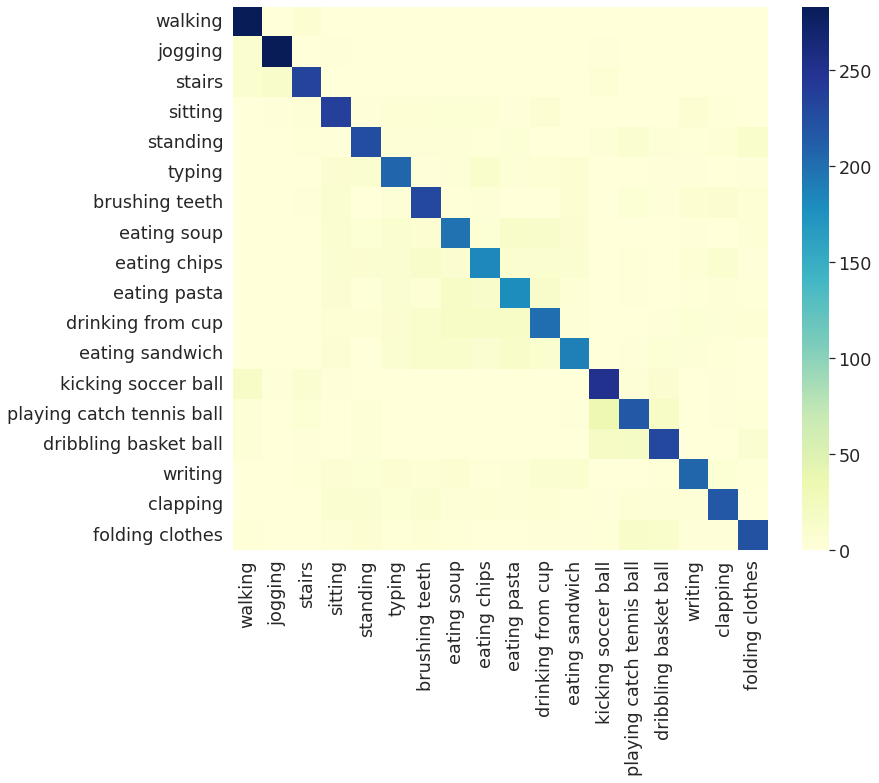

In [176]:
sns.set(font_scale=1.6)
fig, ax = plt.subplots(figsize=(12,10))
_ = sns.heatmap(cm_act, cmap="YlGnBu")

In [177]:
sns.set(font_scale=1.2)

In [178]:
accuracy_per_activity = pd.DataFrame([cm_act.iloc[i][i]/np.sum(cm_act.iloc[i]) for i in range(18)],index=activity_codes_mapping.values())
accuracy_per_activity

,0
walking,0.969178
jogging,0.946488
stairs,0.876866
sitting,0.820069
standing,0.768707
typing,0.768657
brushing teeth,0.782313
eating soup,0.692308
eating chips,0.648936
eating pasta,0.669145


In [179]:
print(classification_report(y_true=y_test,
                            y_pred=y_test_pred))

              precision    recall  f1-score   support

           A       0.84      0.97      0.90       292
           B       0.93      0.95      0.94       299
           C       0.85      0.88      0.86       268
           D       0.73      0.82      0.77       289
           E       0.77      0.77      0.77       294
           F       0.73      0.77      0.75       268
           G       0.74      0.78      0.76       294
           H       0.70      0.69      0.70       286
           I       0.70      0.65      0.68       282
           J       0.70      0.67      0.68       269
           K       0.72      0.67      0.69       301
           L       0.76      0.66      0.71       283
           M       0.78      0.84      0.81       299
           O       0.75      0.75      0.75       290
           P       0.79      0.80      0.80       287
           Q       0.82      0.73      0.77       283
           R       0.80      0.75      0.77       291
           S       0.80    

In [180]:
accuracy_score(y_true = y_test, y_pred = y_test_pred)

0.7739686228936665